<a href="https://colab.research.google.com/github/sangmu1126/NewJeanse/blob/main/test_t.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import json
import pandas as pd
import glob
import numpy as np

# JSON 파일 로드 함수
def load_weather_json_files(pattern):
    files = glob.glob(pattern)
    data_list = []
    for file in files:
        with open(file, 'r', encoding='utf-8') as f:
            data = json.load(f)
            year = int(file.split('_')[1])
            month = int(file.split('_')[2].split('.')[0])
            for record in data['data']:
                record['year'] = year
                record['month'] = month
                data_list.append(record)
    return pd.DataFrame(data_list)

# 전력 사용량 데이터 로드 함수
def load_power_data(pattern):
    files = glob.glob(pattern)
    data_list = []
    for file in files:
        with open(file, 'r', encoding='utf-8') as f:
            data = json.load(f)
            for record in data['data']:
                year = int(record['year'])
                month = int(record['month'])
                record['year'] = year
                record['month'] = month
                data_list.append(record)
    return pd.DataFrame(data_list)

# 날씨 데이터 로드
weather_df = load_weather_json_files("weather_*.json")
print("Weather Data Loaded")
print(weather_df.head())

# 전력 사용량 데이터 로드
power_df = load_power_data("data_*.json")
print("Power Usage Data Loaded")
print(power_df.head())


Weather Data Loaded
Empty DataFrame
Columns: []
Index: []
Power Usage Data Loaded
Empty DataFrame
Columns: []
Index: []


In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
os.chdir('/content/drive/MyDrive/NewJeanse')
!pwd

Mounted at /content/drive
/content/drive/MyDrive/NewJeanse


In [ ]:
import json
import pandas as pd
import glob
import numpy as np

# JSON 파일 로드 함수
def load_weather_json_files(pattern):
    files = glob.glob(pattern)
    data_list = []
    for file in files:
        with open(file, 'r', encoding='utf-8') as f:
            data = json.load(f)
            year = int(file.split('_')[1])
            month = int(file.split('_')[2].split('.')[0])
            for record in data['data']:
                record['year'] = year
                record['month'] = month
                data_list.append(record)
    return pd.DataFrame(data_list)

# 전력 사용량 데이터 로드 함수
def load_power_data(pattern):
    files = glob.glob(pattern)
    data_list = []
    for file in files:
        with open(file, 'r', encoding='utf-8') as f:
            data = json.load(f)
            for record in data['data']:
                year = int(record['year'])
                month = int(record['month'])
                record['year'] = year
                record['month'] = month
                data_list.append(record)
    return pd.DataFrame(data_list)

# 날씨 데이터 로드
weather_df = load_weather_json_files("weather_*.json")
print("Weather Data Loaded")
print(weather_df.head())

# 전력 사용량 데이터 로드
power_df = load_power_data("data_*.json")
print("Power Usage Data Loaded")
print(power_df.head())


Weather Data Loaded
  stnid stnko      pa avgtamax avgtamin taavg avghm  year  month
0    90    속초  1019.8      5.6     -2.1   1.8    52  2015      1
1    95    철원  1005.3      2.1    -10.0  -4.0    67  2015      1
2    98   동두천  1010.5      4.0     -7.4  -2.3    61  2015      1
3    99    파주  1021.2      3.1     -9.0  -3.1    61  2015      1
4   100   대관령   928.8      0.2    -11.2  -5.2    69  2015      1
Power Usage Data Loaded
   year  month metro city                 biz  custCnt   powerUsage  \
0  2015      1    전체   전체        농업, 임업 및 어업   1432662   1537862265   
1  2015      1    전체   전체                 광업      4165    139833009   
2  2015      1    전체   전체                제조업    305372  21658719771   
3  2015      1    전체   전체  전기, 가스, 증기 및 수도사업     63275    950204818   
4  2015      1    전체   전체      하수폐기처리원료재생환경복원    37114    553237884   

            bill  unitCost  
0    73671381775      47.9  
1    19677426698     140.7  
2  2483632841558     114.7  
3   116142972206     12

In [ ]:
# data 파일에서 city값에서 뒤의 한글자를 제거하는 함수
def preprocess_city_name(city_name):
    if city_name != '전체':
        return city_name[:-1]
    return city_name

# 전력 사용량 데이터에서 city 값 전처리
if 'city' in power_df.columns:
    power_df['city'] = power_df['city'].apply(preprocess_city_name)
else:
    raise KeyError("The 'city' column is missing from the power_df dataframe")
print("City Names Preprocessed")
print(power_df.head())

# 데이터 병합 조건 설정
weather_df['key'] = weather_df['stnko']
power_df['key'] = power_df['city']

# 데이터 병합
merged_df = pd.merge(weather_df, power_df, on=['year', 'month', 'key'])
print("Data Merged")
print(merged_df.head())


City Names Preprocessed
   year  month metro city                 biz  custCnt   powerUsage  \
0  2015      1    전체   전체        농업, 임업 및 어업   1432662   1537862265   
1  2015      1    전체   전체                 광업      4165    139833009   
2  2015      1    전체   전체                제조업    305372  21658719771   
3  2015      1    전체   전체  전기, 가스, 증기 및 수도사업     63275    950204818   
4  2015      1    전체   전체      하수폐기처리원료재생환경복원    37114    553237884   

            bill  unitCost  
0    73671381775      47.9  
1    19677426698     140.7  
2  2483632841558     114.7  
3   116142972206     122.2  
4    64952497784     117.4  
Data Merged
  stnid stnko      pa avgtamax avgtamin taavg avghm  year  month key metro  \
0    90    속초  1019.8      5.6     -2.1   1.8    52  2015      1  속초   강원도   
1    90    속초  1019.8      5.6     -2.1   1.8    52  2015      1  속초   강원도   
2    90    속초  1019.8      5.6     -2.1   1.8    52  2015      1  속초   강원도   
3    90    속초  1019.8      5.6     -2.1   1.8    52

In [ ]:
# 필요한 전력 데이터만 필터링
filtered_df = merged_df[['year', 'month', 'stnid', 'stnko', 'pa', 'avgtamax', 'avgtamin', 'taavg', 'avghm', 'biz', 'powerUsage']]
print("Filtered Data")
print(filtered_df.head())

# 2016년부터 2023년까지의 데이터 필터링
final_df = filtered_df[(filtered_df['year'] >= 2016) & (filtered_df['year'] <= 2023)]
print("Filtered Data for 2016-2023")
print(final_df.head())

# null 값을 NaN으로 변환
final_df.replace("null", np.nan, inplace=True)

# 결측치 처리 - 연도와 월을 기준으로 보간
final_df = final_df.sort_values(by=['stnko', 'year', 'month'])
final_df = final_df.groupby('stnko').apply(lambda group: group.interpolate(method='linear')).reset_index(drop=True)

# 결측치가 남아있다면 0으로 채움
final_df.fillna(0, inplace=True)
print("Missing Values Handled")
print(final_df.head())


Filtered Data
   year  month stnid stnko      pa avgtamax avgtamin taavg avghm  \
0  2015      1    90    속초  1019.8      5.6     -2.1   1.8    52   
1  2015      1    90    속초  1019.8      5.6     -2.1   1.8    52   
2  2015      1    90    속초  1019.8      5.6     -2.1   1.8    52   
3  2015      1    90    속초  1019.8      5.6     -2.1   1.8    52   
4  2015      1    90    속초  1019.8      5.6     -2.1   1.8    52   

                  biz  powerUsage  
0                건설업       552300  
1  공공행정, 국방 및 사회보장 행정     1529680  
2                 광업       121372  
3             교육 서비스업     1262550  
4           금융 및 보험업       346139  
Filtered Data for 2016-2023
      year  month stnid stnko      pa avgtamax avgtamin taavg avghm  \
2471  2016      6    90    속초  1005.5     24.3     17.5  20.6    82   
2472  2016      6    90    속초  1005.5     24.3     17.5  20.6    82   
2473  2016      6    90    속초  1005.5     24.3     17.5  20.6    82   
2474  2016      6    90    속초  1005.5     24.3   

<ipython-input-5-a5d7fa09b7c9>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_df.replace("null", np.nan, inplace=True)


Missing Values Handled
   year  month stnid stnko      pa avgtamax avgtamin taavg avghm  \
0  2016      6   105    강릉  1004.7     25.9     18.3  21.9    66   
1  2016      6   105    강릉  1004.7     25.9     18.3  21.9    66   
2  2016      6   105    강릉  1004.7     25.9     18.3  21.9    66   
3  2016      6   105    강릉  1004.7     25.9     18.3  21.9    66   
4  2016      6   105    강릉  1004.7     25.9     18.3  21.9    66   

                  biz  powerUsage  
0     가구내고용,미분류자가소비생산         215  
1                건설업      1789907  
2  공공행정, 국방 및 사회보장 행정     2076593  
3                 광업       157069  
4             교육 서비스업     3229685  


In [ ]:
# 범주형 데이터 인코딩 (업종)
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
final_df['biz'] = label_encoder.fit_transform(final_df['biz'])
print("Categorical Data Encoded")
print(final_df.head())

# 도시별로 학습 및 평가
cities = final_df['stnko'].unique()
results = []

for city in cities:
    city_df = final_df[final_df['stnko'] == city]

    # 특징 및 레이블 설정
    X = city_df[['year', 'month', 'stnid', 'pa', 'avgtamax', 'avgtamin', 'taavg', 'avghm', 'biz']].astype(float).values
    y = city_df['powerUsage'].astype(float).values

    # 데이터 정규화
    from sklearn.preprocessing import MinMaxScaler
    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X = scaler_X.fit_transform(X)
    y = scaler_y.fit_transform(y.reshape(-1, 1)).flatten()

    # 학습 및 테스트 데이터 분할
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # LSTM 모델을 위한 데이터 형태 변환
    X_train = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))
    X_test = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

    # 모델 정의
    import tensorflow as tf
    from tensorflow.keras.models import Sequential
    from tensorflow.keras.layers import LSTM, Dense, Dropout
    from tensorflow.keras.callbacks import EarlyStopping

    model = Sequential([
        LSTM(128, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True),
        Dropout(0.2),
        LSTM(64, activation='relu'),
        Dropout(0.2),
        Dense(32, activation='relu'),
        Dense(1)
    ])

    # 모델 컴파일
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mse', metrics=['mae'])

    # 조기 종료 설정
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # 모델 학습
    history = model.fit(X_train, y_train, epochs=100, validation_split=0.2, batch_size=32, verbose=1, callbacks=[early_stopping])

    # 모델 평가
    loss, mae = model.evaluate(X_test, y_test)
    print(f'Mean Absolute Error for {city}: {mae}')

    # 예측 수행
    y_pred = model.predict(X_test)

    # 예측 결과와 실제 값 비교
    y_test_inverse = scaler_y.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_pred_inverse = scaler_y.inverse_transform(y_pred).flatten()

    city_results = pd.DataFrame({'City': city, 'Actual': y_test_inverse, 'Predicted': y_pred_inverse})
    results.append(city_results)


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
37/37 [==============================] - 0s 12ms/step - loss: 0.0227 - mae: 0.0604 - val_loss: 0.0254 - val_mae: 0.0695
Epoch 37/100
37/37 [==============================] - 0s 12ms/step - loss: 0.0224 - mae: 0.0602 - val_loss: 0.0246 - val_mae: 0.0616
Epoch 38/100
37/37 [==============================] - 0s 11ms/step - loss: 0.0228 - mae: 0.0612 - val_loss: 0.0249 - val_mae: 0.0650
Epoch 39/100
37/37 [==============================] - 0s 12ms/step - loss: 0.0226 - mae: 0.0592 - val_loss: 0.0245 - val_mae: 0.0615
Epoch 40/100
37/37 [==============================] - 0s 12ms/step - loss: 0.0226 - mae: 0.0603 - val_loss: 0.0253 - val_mae: 0.0572
Epoch 41/100
37/37 [==============================] - 0s 12ms/step - loss: 0.0234 - mae: 0.0622 - val_loss: 0.0249 - val_mae: 0.0631
Epoch 42/100
37/37 [==============================] - 0s 11ms/step - loss: 0.0223 - mae: 0.0591 - val_loss: 0.0245 - val_mae: 0.0611
Epoch 43/100
37/37 [==========================

  City     Actual   Predicted
0   강릉   442304.0   6222915.5
1   강릉   379833.0   5668188.0
2   강릉   602728.0  11606442.0
3   강릉  4217808.0   5066969.5
4   강릉  3259204.0   7522061.0


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44053 (\N{HANGUL SYLLABLE GANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 47497 (\N{HANGUL SYLLABLE REUNG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


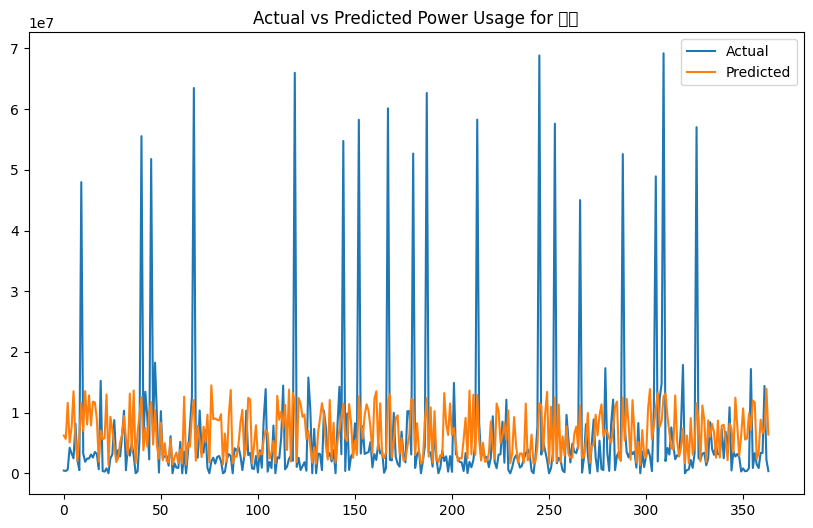

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54868 (\N{HANGUL SYLLABLE HWA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


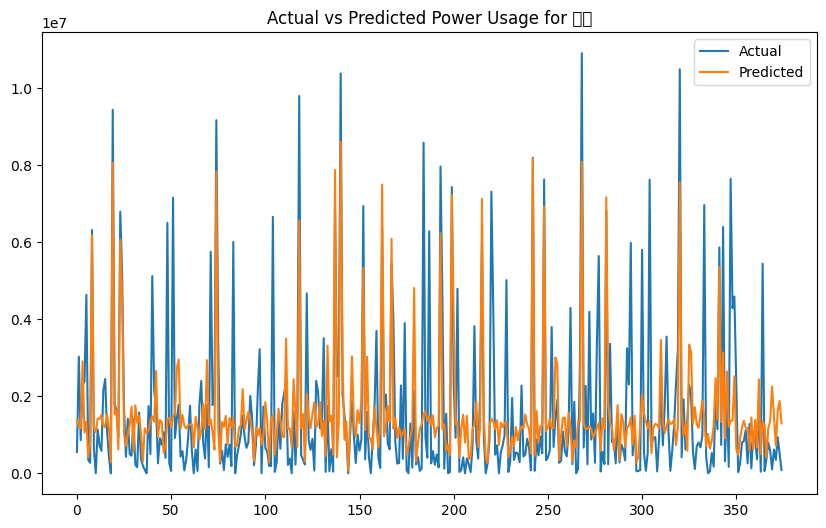

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44144 (\N{HANGUL SYLLABLE GEO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51228 (\N{HANGUL SYLLABLE JE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


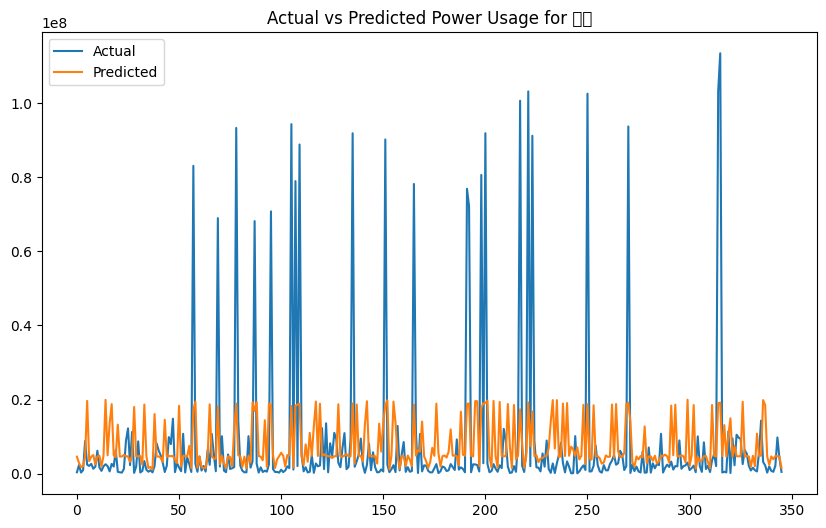

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52285 (\N{HANGUL SYLLABLE CANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


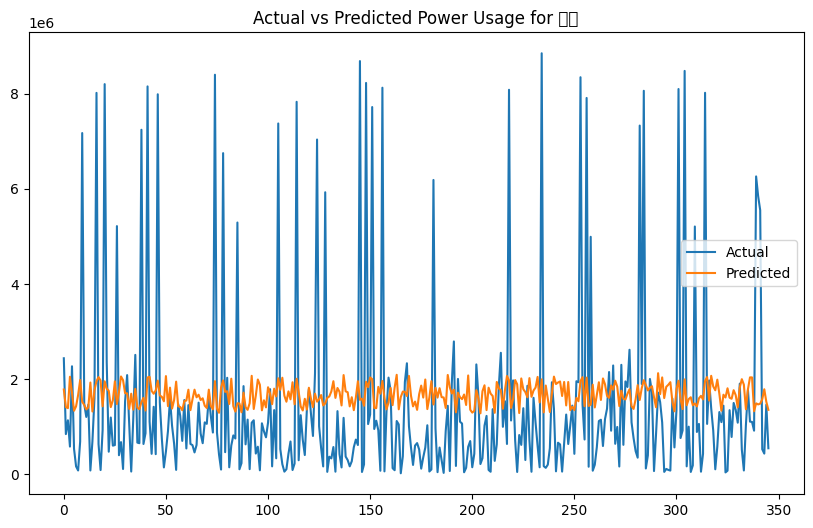

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44256 (\N{HANGUL SYLLABLE GO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


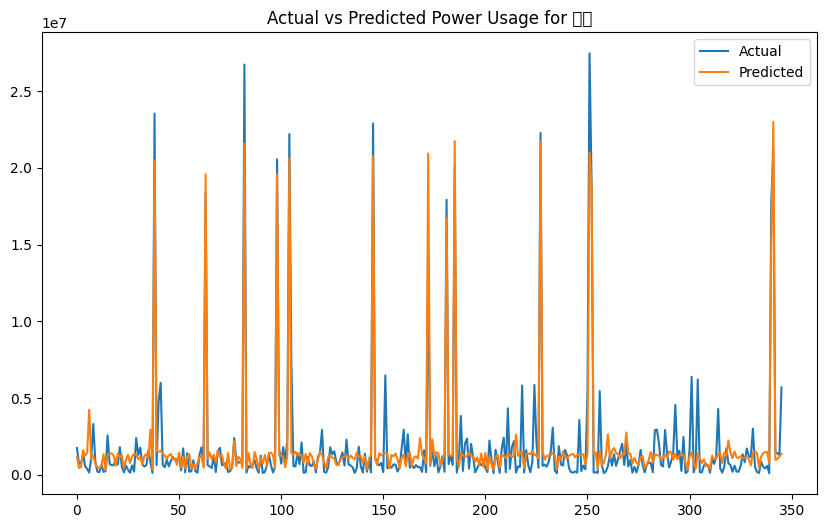

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 55141 (\N{HANGUL SYLLABLE HEUNG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


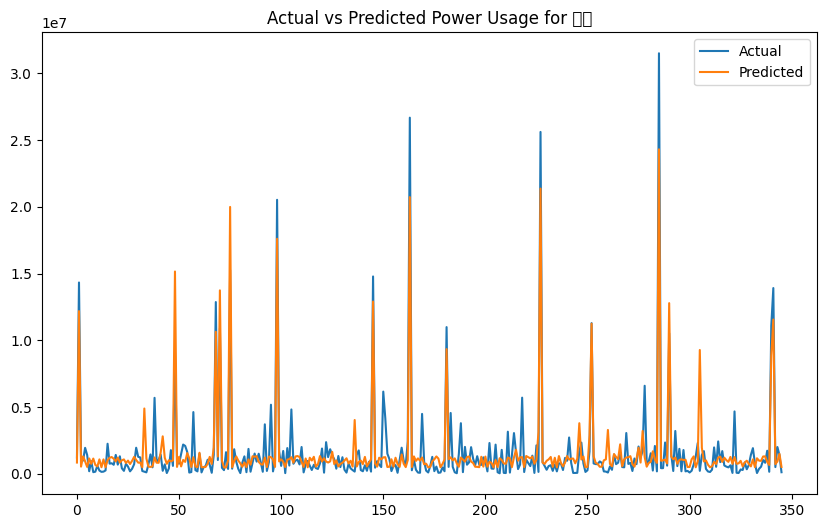

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44305 (\N{HANGUL SYLLABLE GWANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51452 (\N{HANGUL SYLLABLE JU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


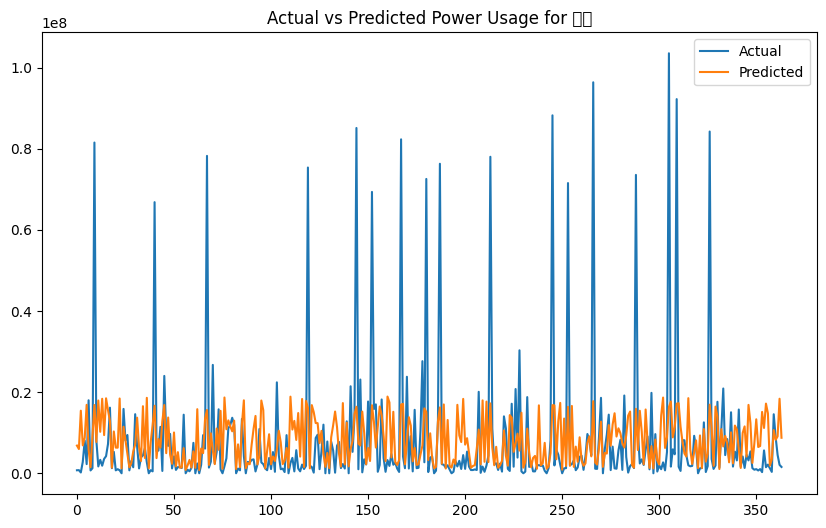

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44396 (\N{HANGUL SYLLABLE GU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48120 (\N{HANGUL SYLLABLE MI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


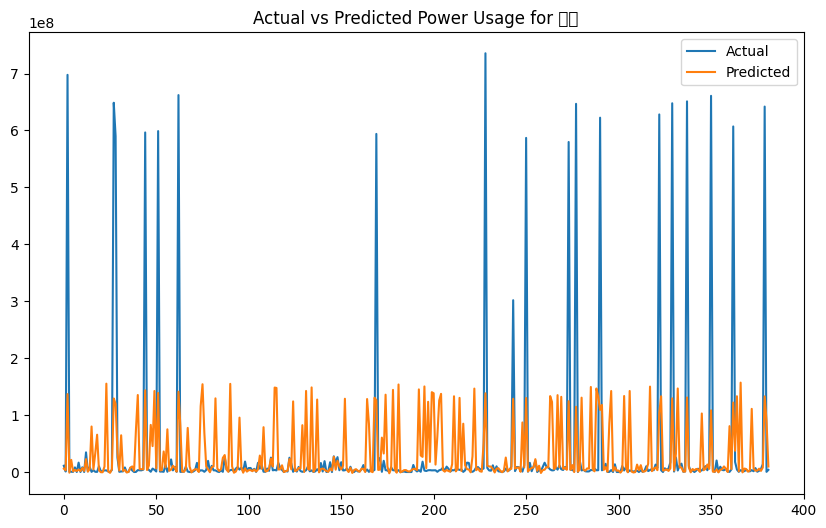

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44400 (\N{HANGUL SYLLABLE GUN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49328 (\N{HANGUL SYLLABLE SAN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


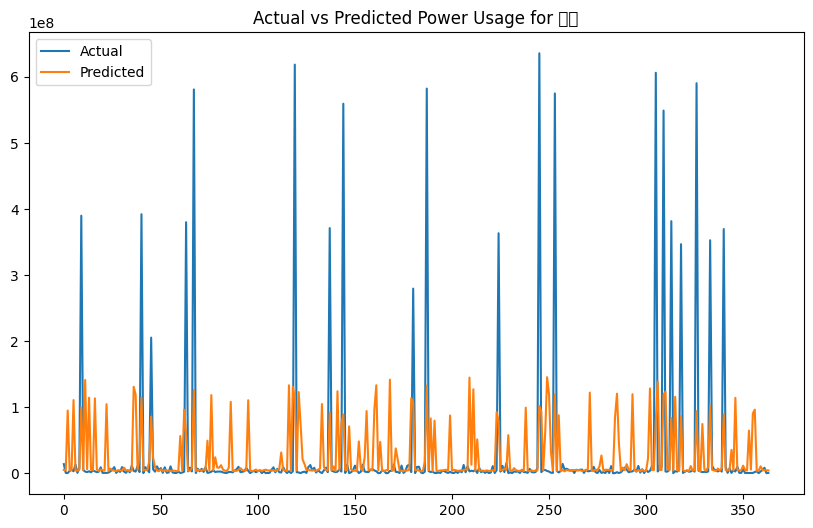

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44552 (\N{HANGUL SYLLABLE GEUM}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


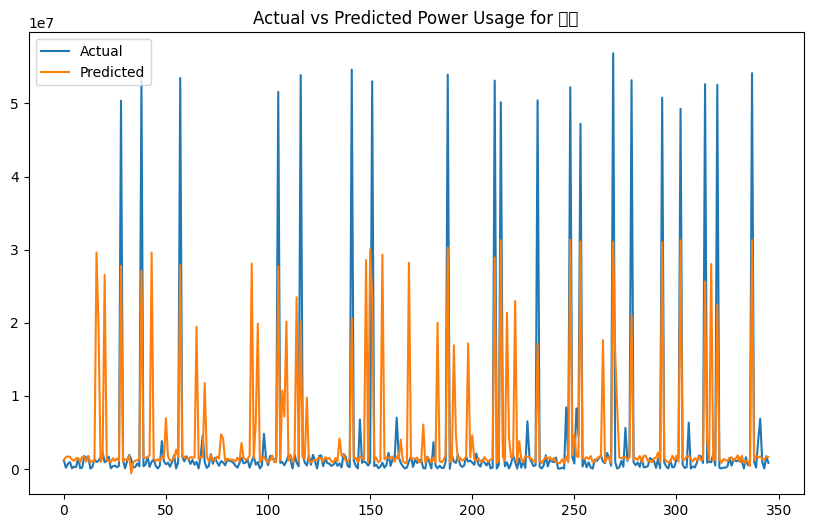

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 45224 (\N{HANGUL SYLLABLE NAM}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50896 (\N{HANGUL SYLLABLE WEON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


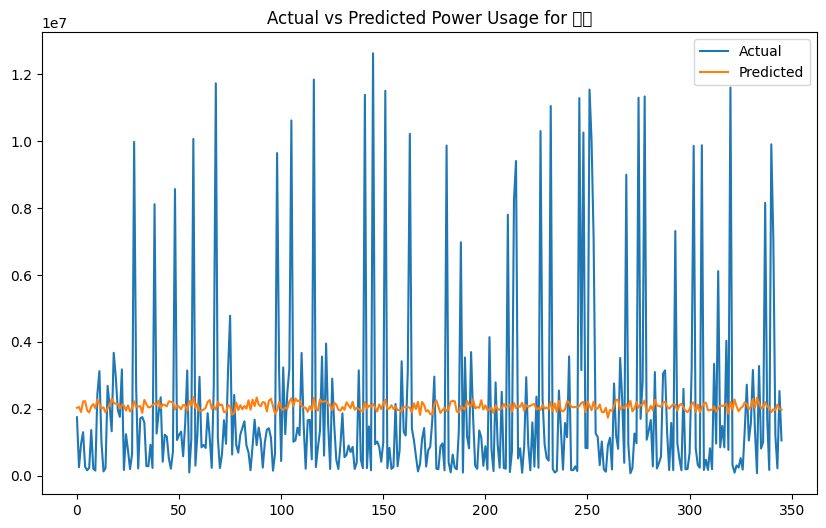

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54644 (\N{HANGUL SYLLABLE HAE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


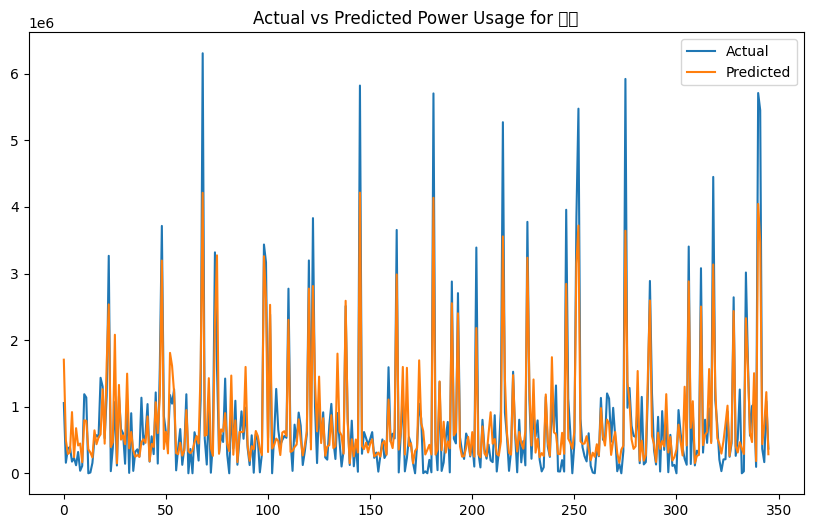

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 46041 (\N{HANGUL SYLLABLE DONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 46160 (\N{HANGUL SYLLABLE DU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52380 (\N{HANGUL SYLLABLE CEON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


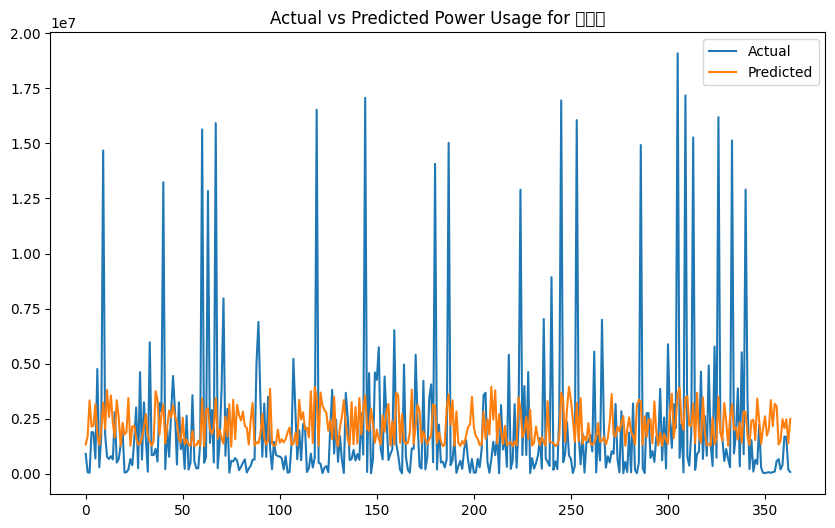

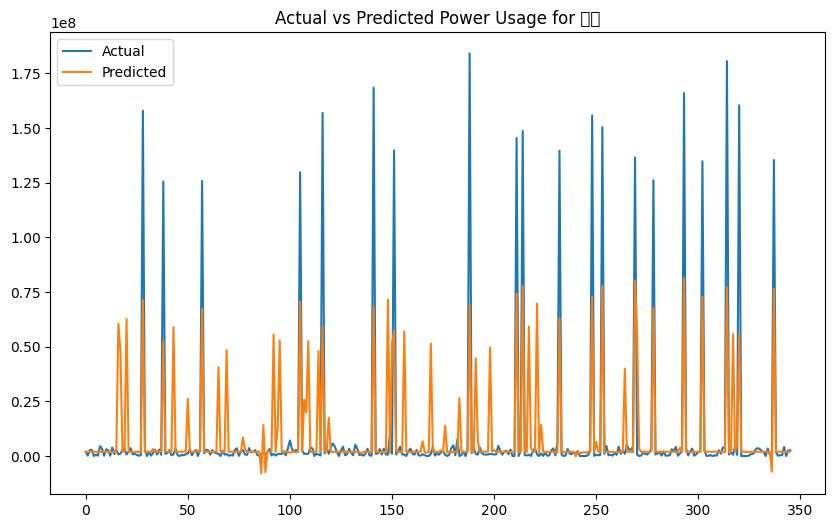

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 47785 (\N{HANGUL SYLLABLE MOG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54252 (\N{HANGUL SYLLABLE PO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


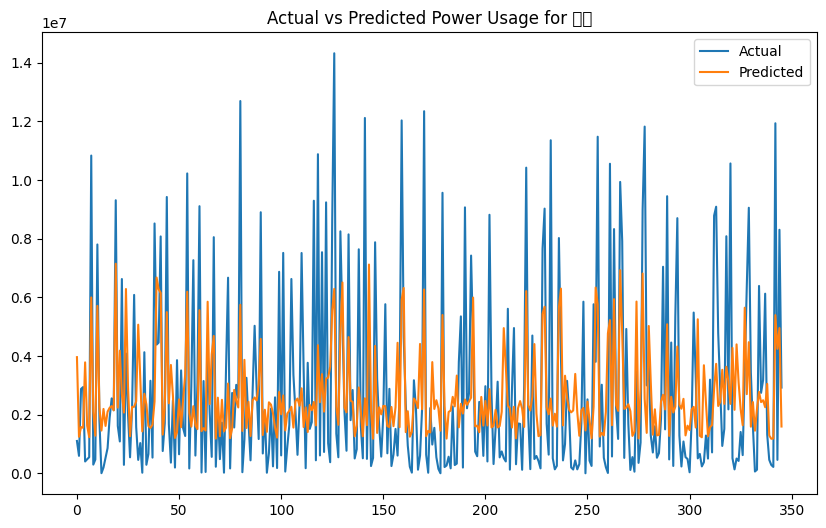

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 47928 (\N{HANGUL SYLLABLE MUN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44221 (\N{HANGUL SYLLABLE GYEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


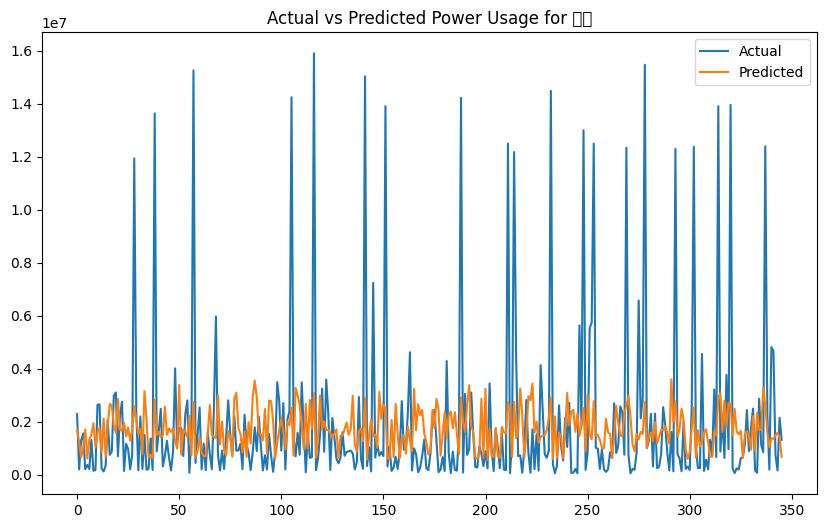

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48128 (\N{HANGUL SYLLABLE MIL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50577 (\N{HANGUL SYLLABLE YANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


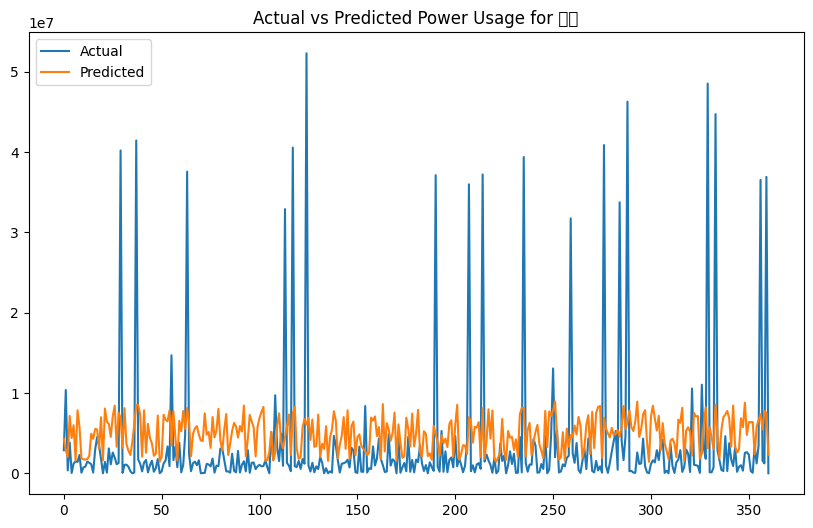

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48372 (\N{HANGUL SYLLABLE BO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 47161 (\N{HANGUL SYLLABLE RYEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


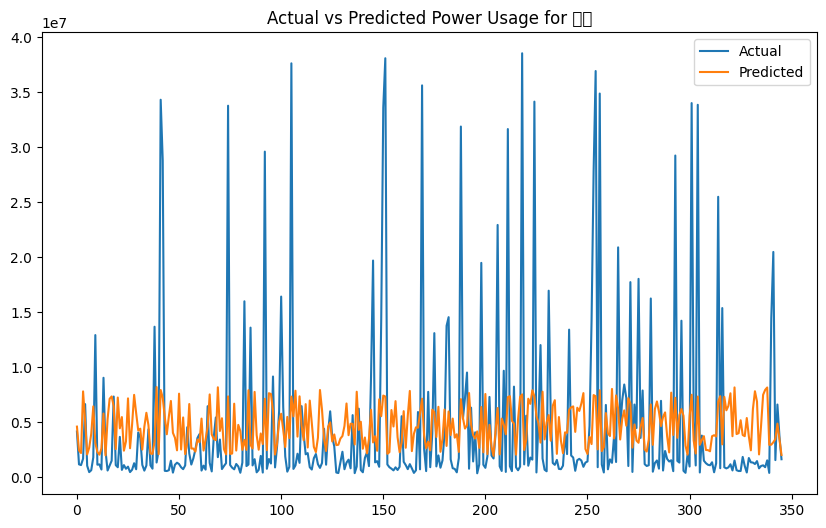

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51008 (\N{HANGUL SYLLABLE EUN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


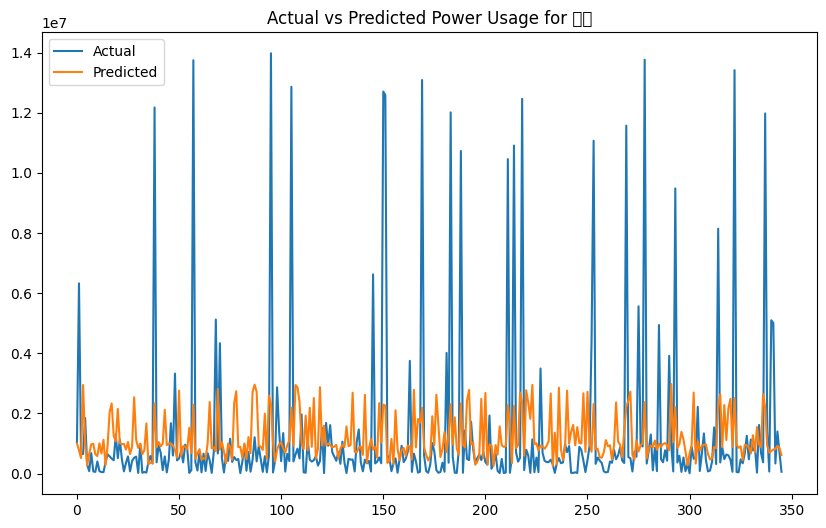

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48393 (\N{HANGUL SYLLABLE BONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


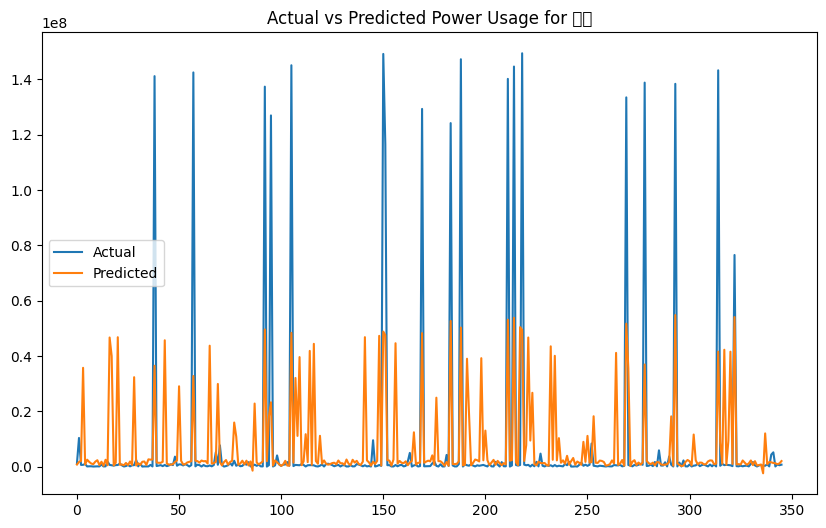

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48512 (\N{HANGUL SYLLABLE BU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50504 (\N{HANGUL SYLLABLE AN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


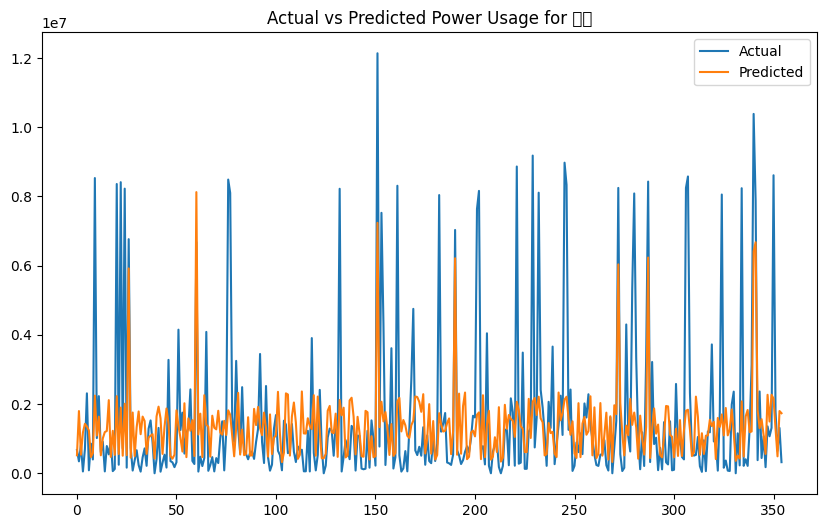

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50668 (\N{HANGUL SYLLABLE YEO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


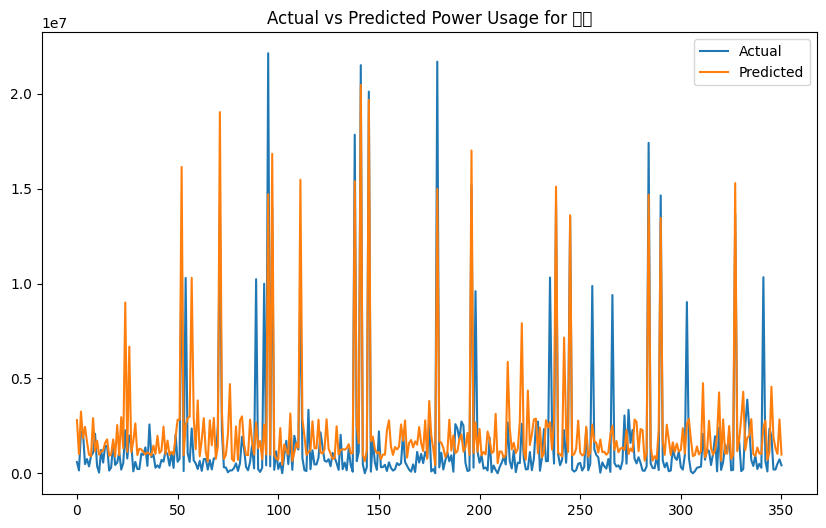

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52397 (\N{HANGUL SYLLABLE CEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


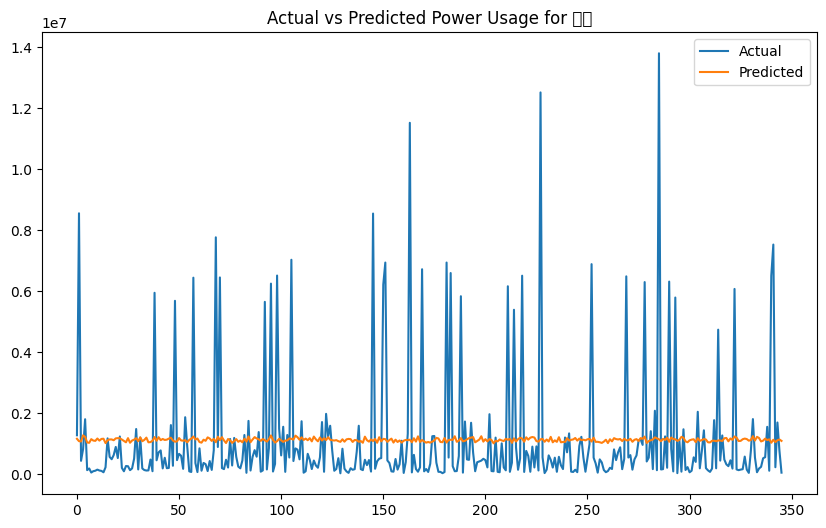

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49345 (\N{HANGUL SYLLABLE SANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


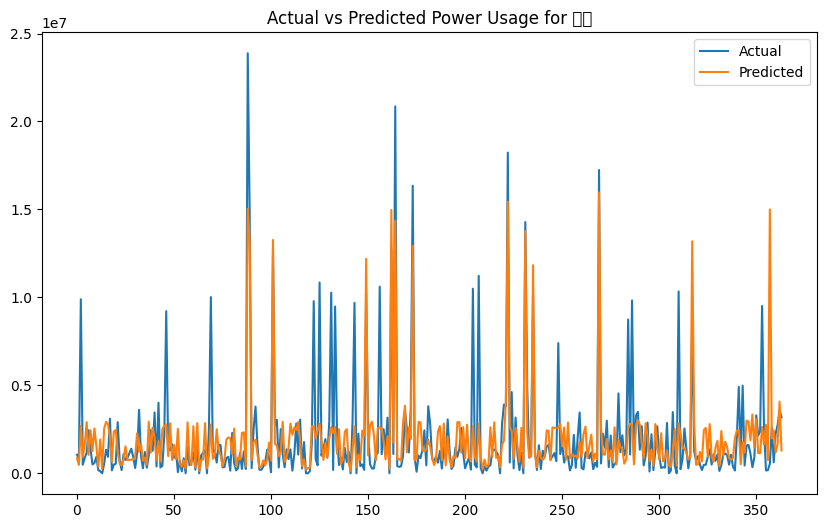

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49436 (\N{HANGUL SYLLABLE SEO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44480 (\N{HANGUL SYLLABLE GWI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


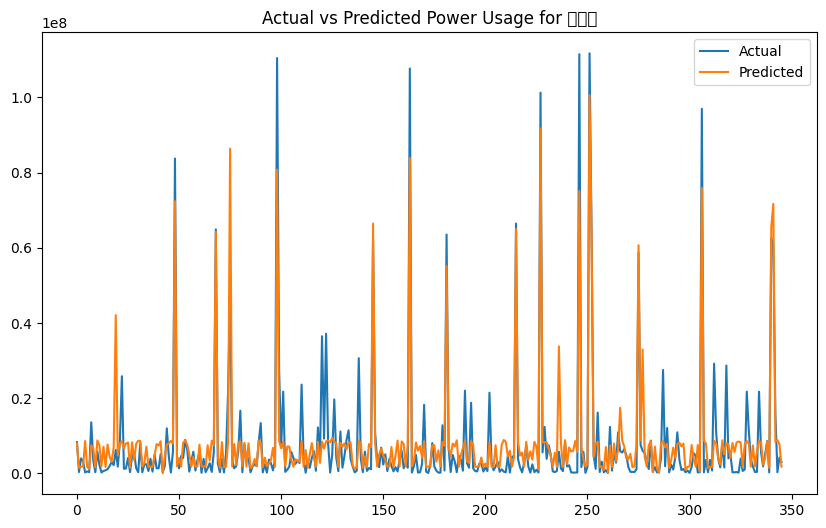

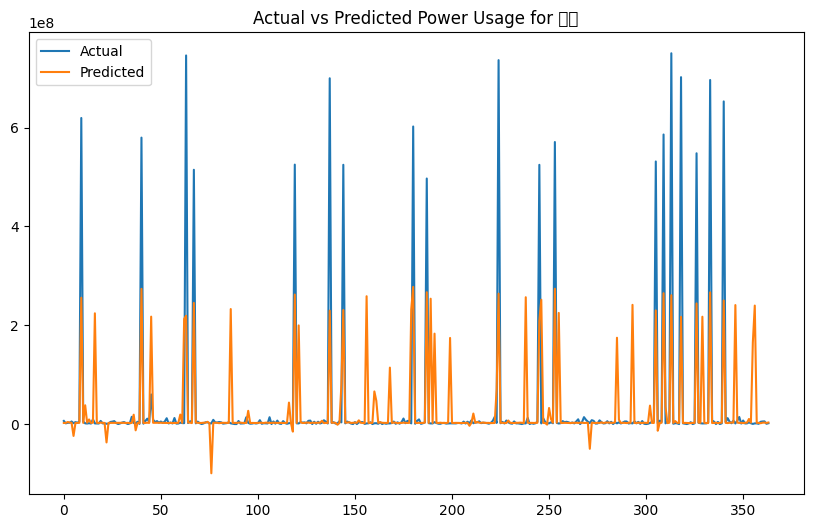

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49464 (\N{HANGUL SYLLABLE SE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51333 (\N{HANGUL SYLLABLE JONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


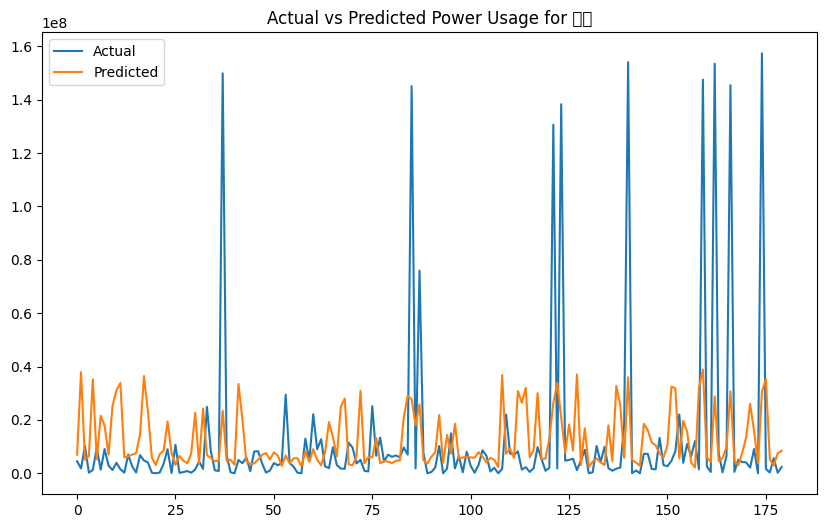

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49549 (\N{HANGUL SYLLABLE SOG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52488 (\N{HANGUL SYLLABLE CO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


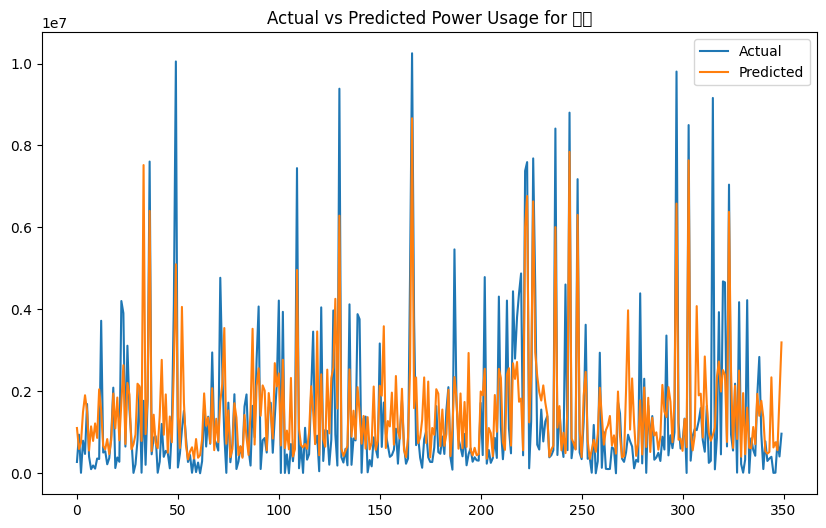

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


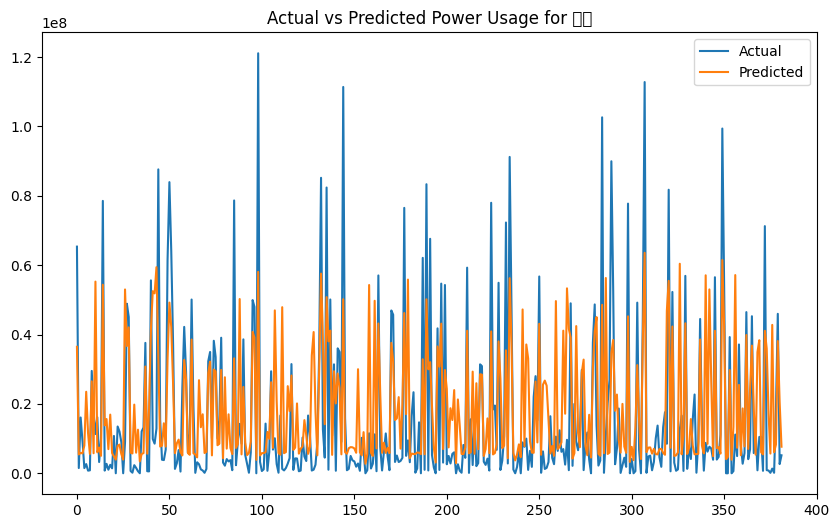

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49692 (\N{HANGUL SYLLABLE SUN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


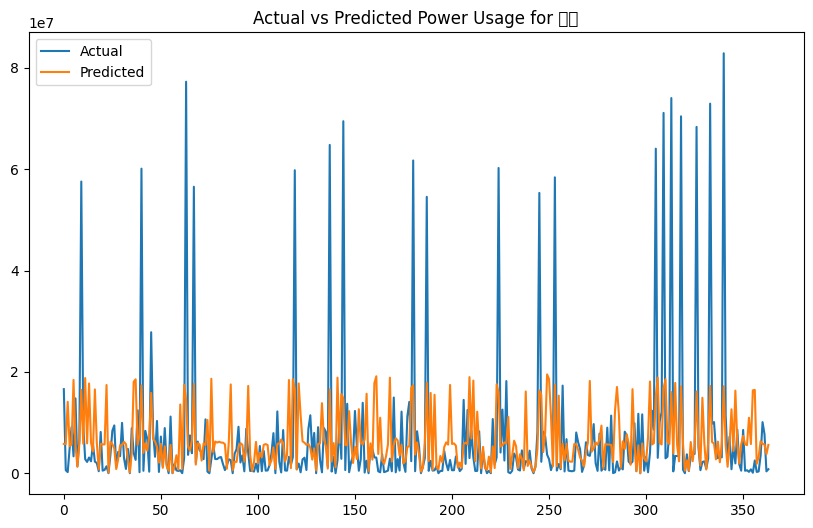

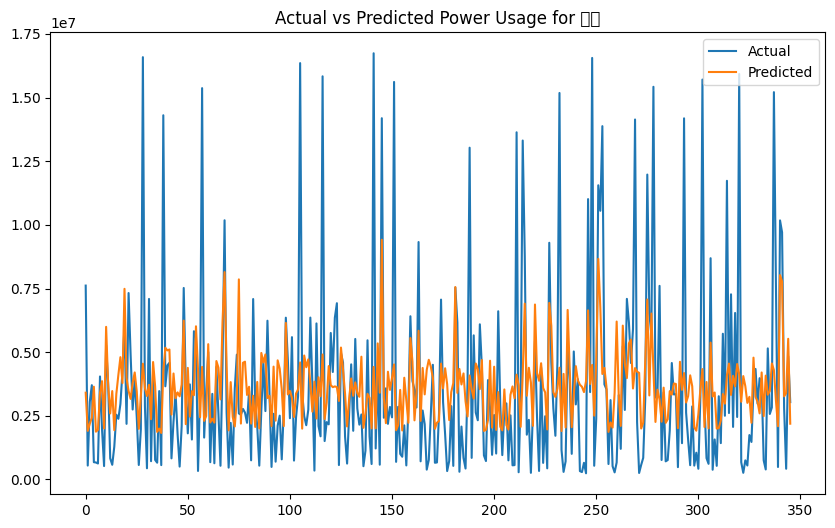

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54217 (\N{HANGUL SYLLABLE PYEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


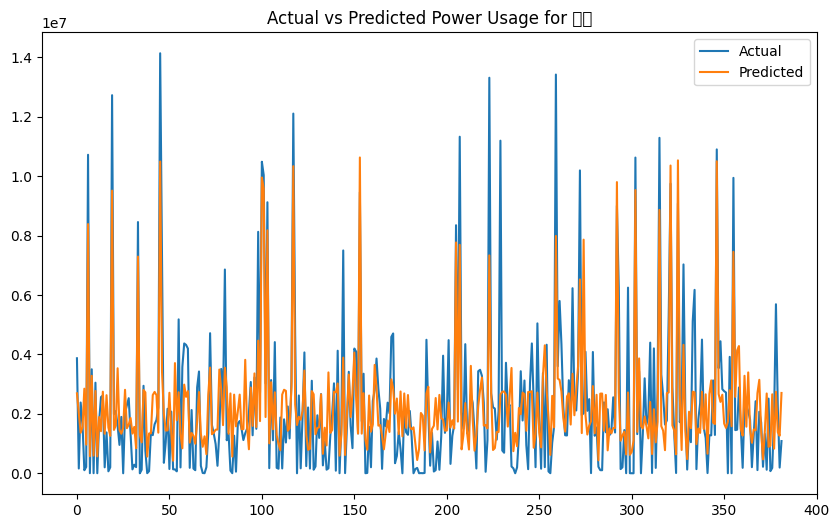

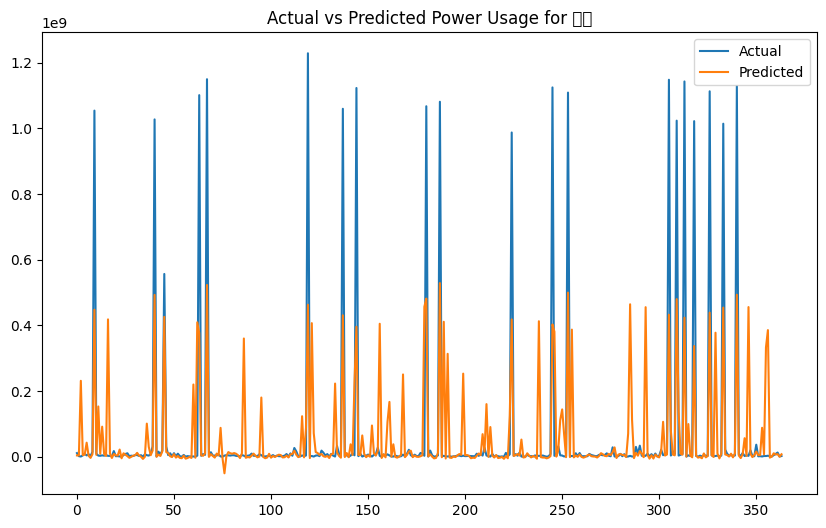

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50689 (\N{HANGUL SYLLABLE YEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 45909 (\N{HANGUL SYLLABLE DEOG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


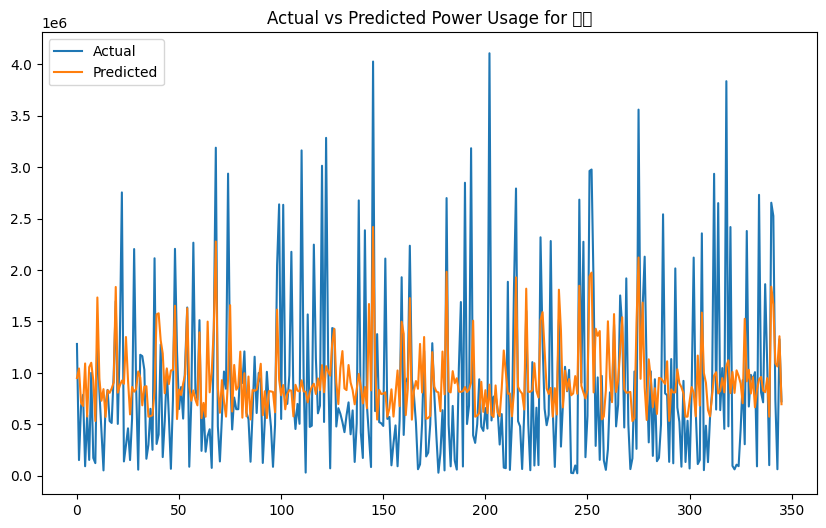

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50900 (\N{HANGUL SYLLABLE WEOL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


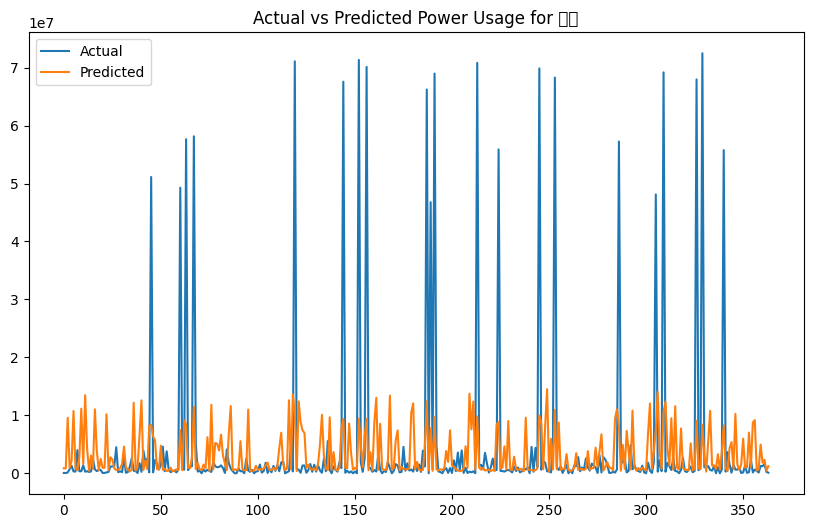

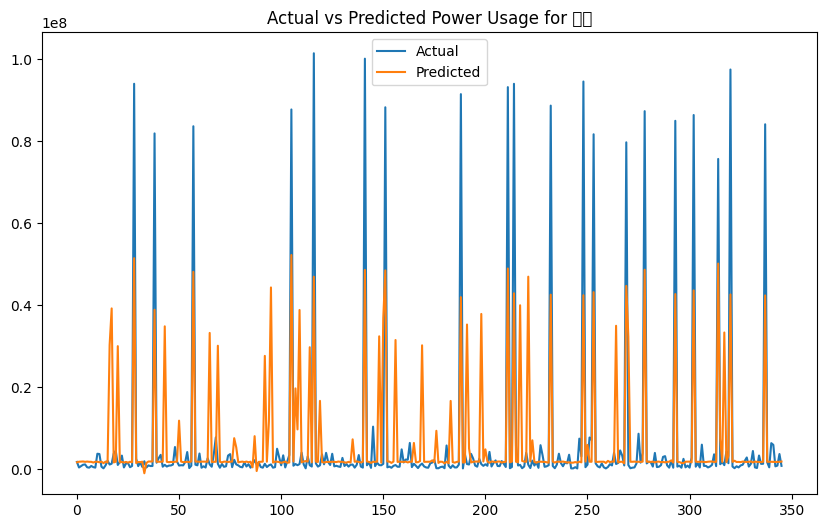

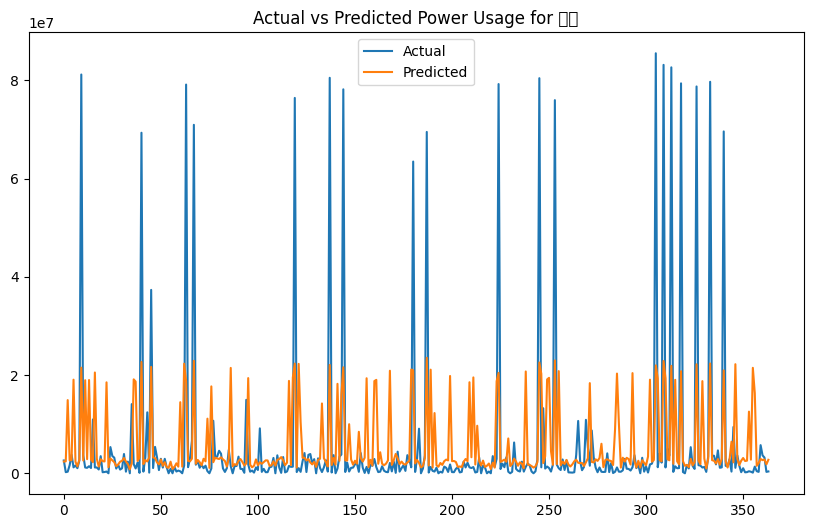

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50756 (\N{HANGUL SYLLABLE WAN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 46020 (\N{HANGUL SYLLABLE DO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


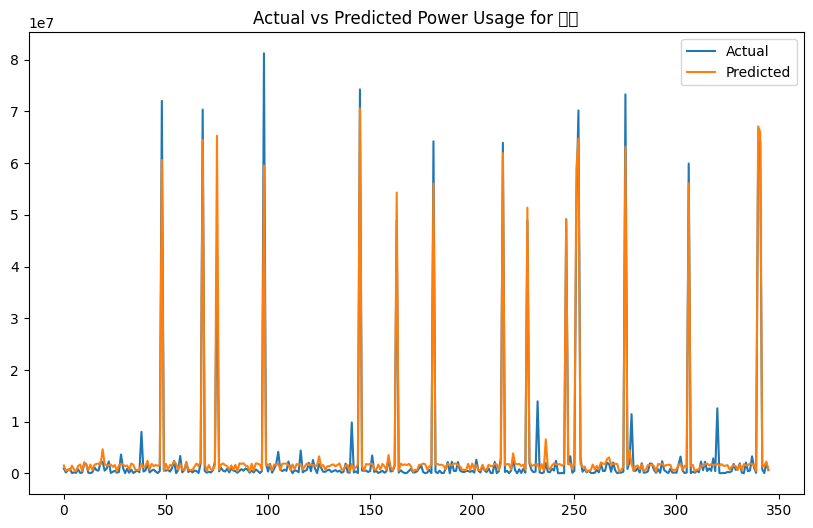

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50872 (\N{HANGUL SYLLABLE UL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51652 (\N{HANGUL SYLLABLE JIN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


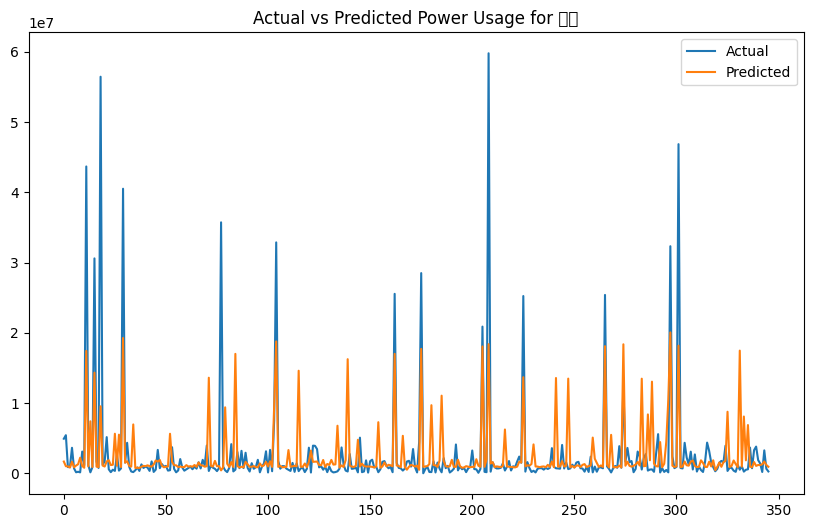

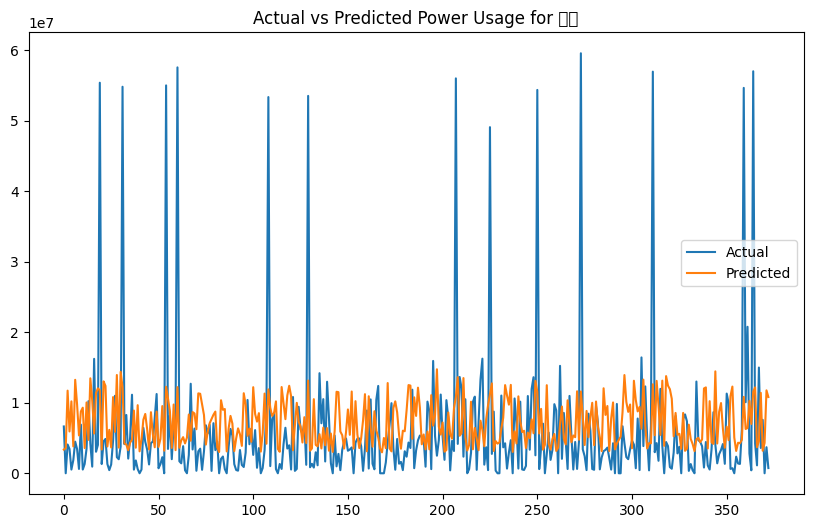

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51032 (\N{HANGUL SYLLABLE YI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49457 (\N{HANGUL SYLLABLE SEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


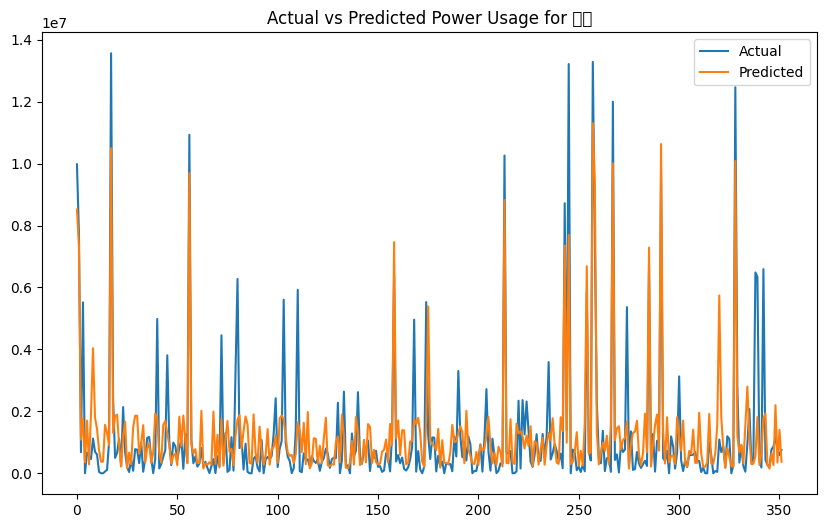

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51060 (\N{HANGUL SYLLABLE I}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


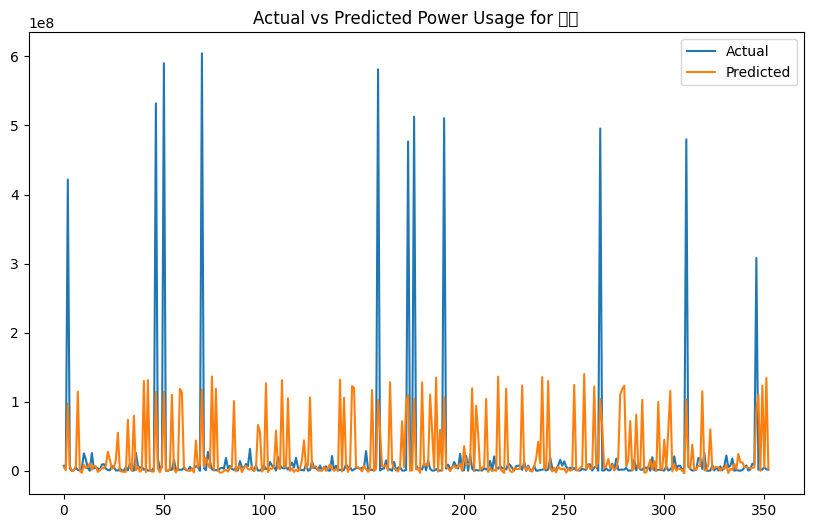

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51064 (\N{HANGUL SYLLABLE IN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


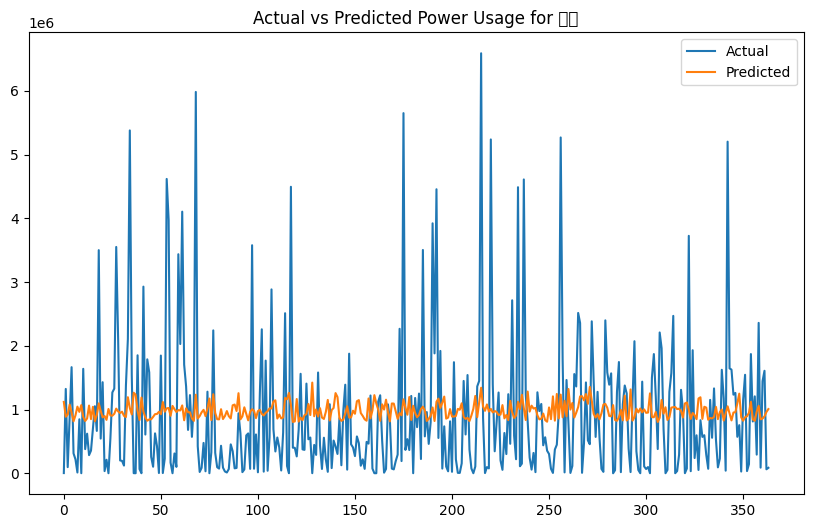

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51076 (\N{HANGUL SYLLABLE IM}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49892 (\N{HANGUL SYLLABLE SIL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


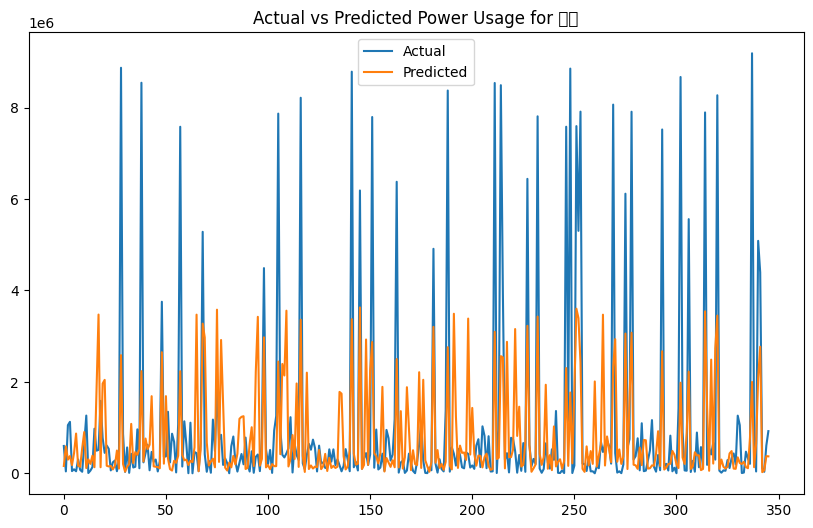

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51109 (\N{HANGUL SYLLABLE JANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


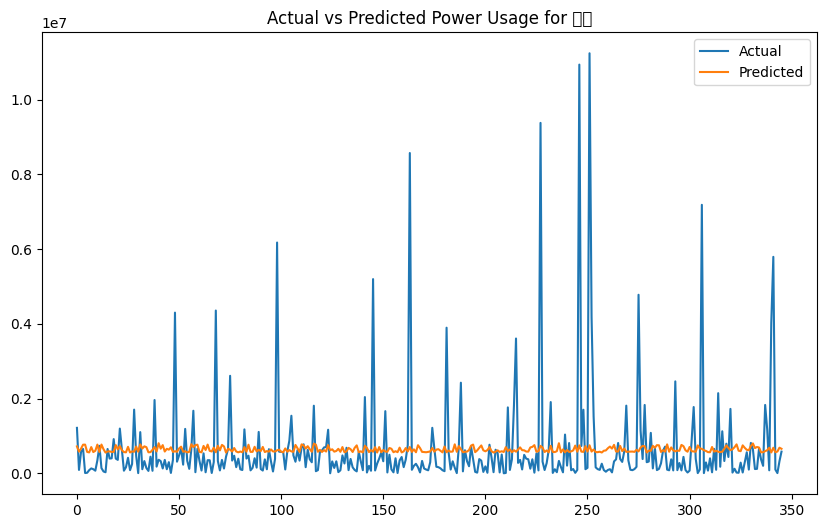

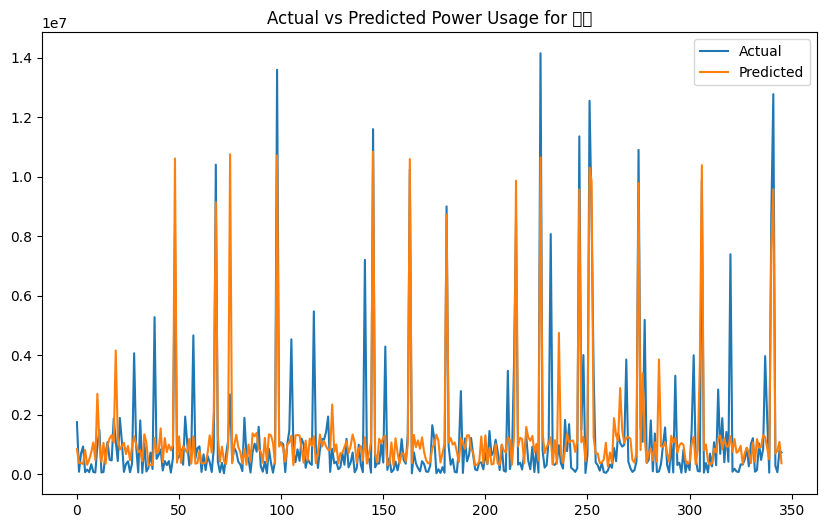

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51204 (\N{HANGUL SYLLABLE JEON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


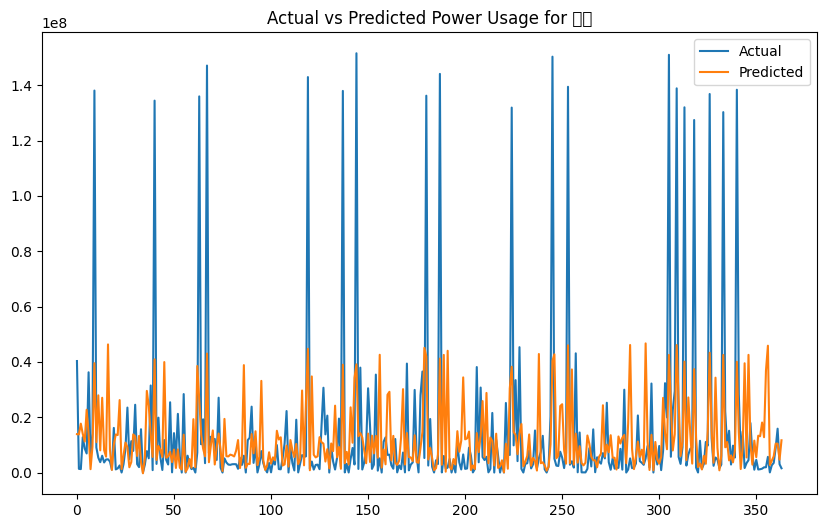

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51221 (\N{HANGUL SYLLABLE JEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51021 (\N{HANGUL SYLLABLE EUB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


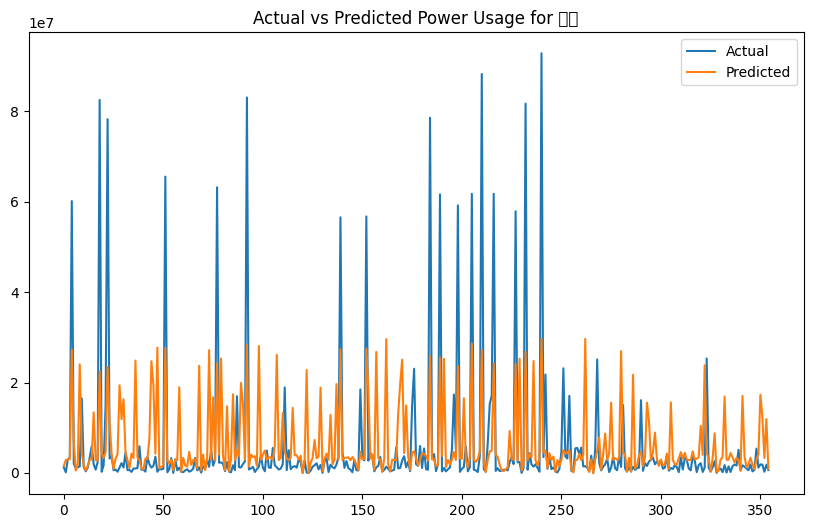

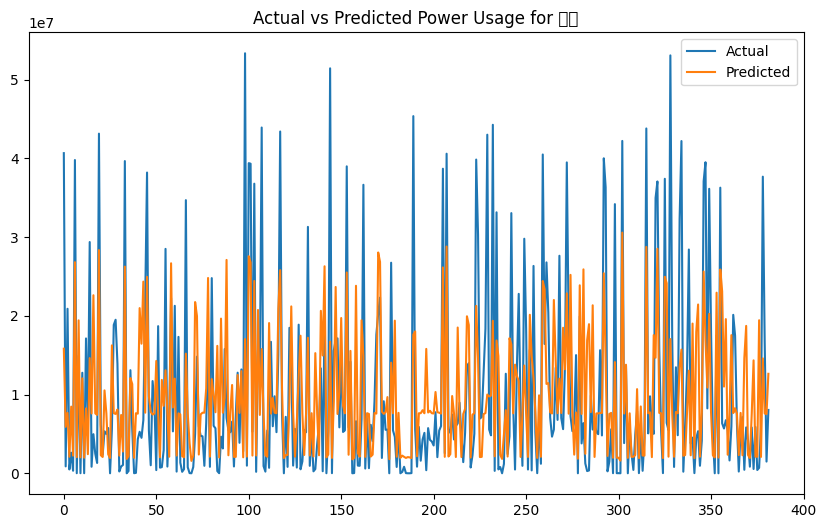

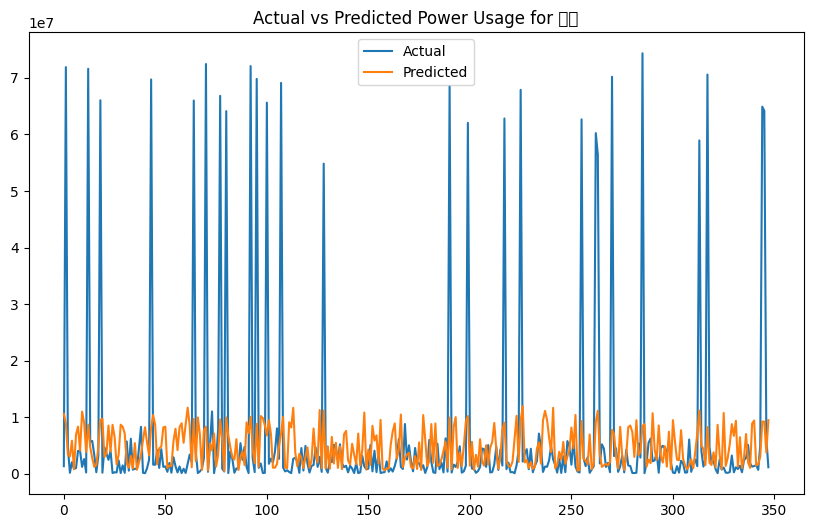

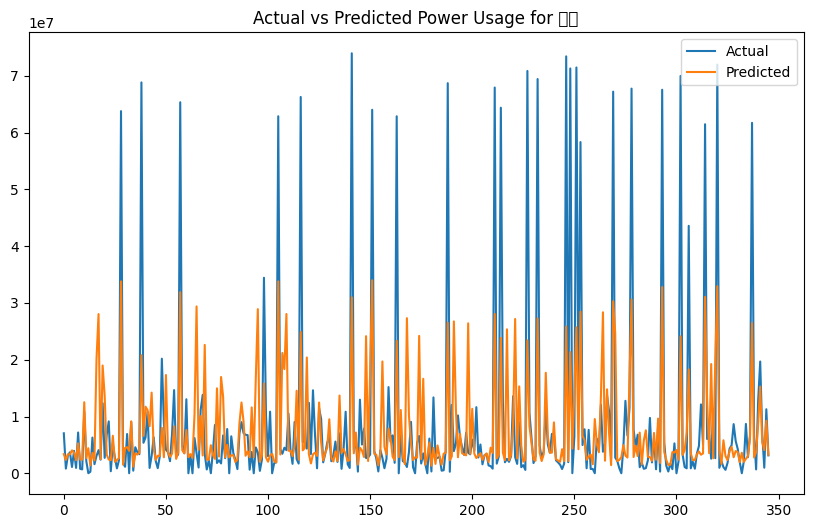

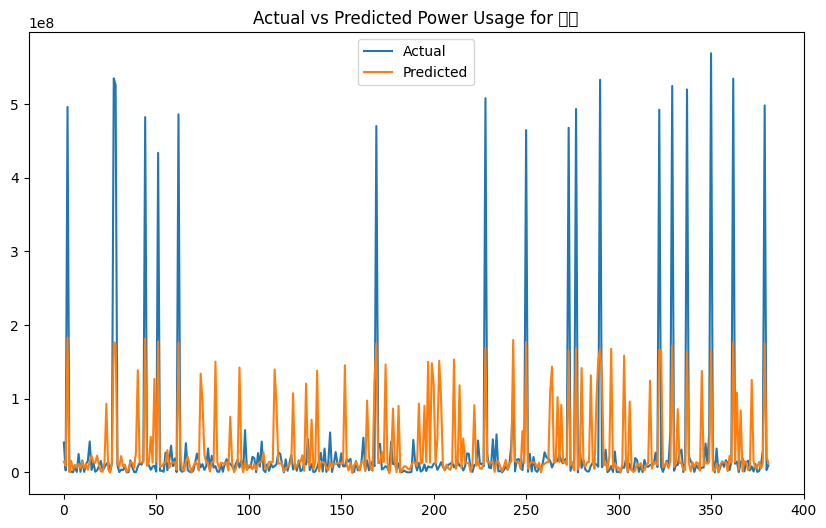

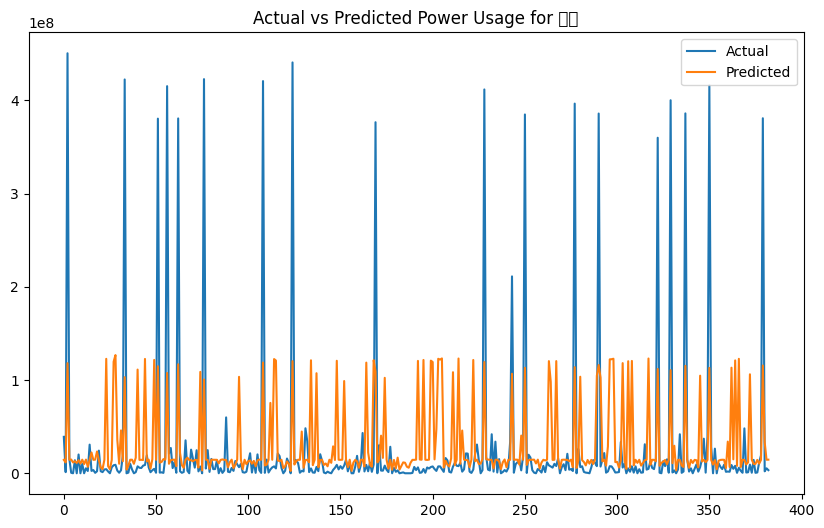

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52384 (\N{HANGUL SYLLABLE CEOL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


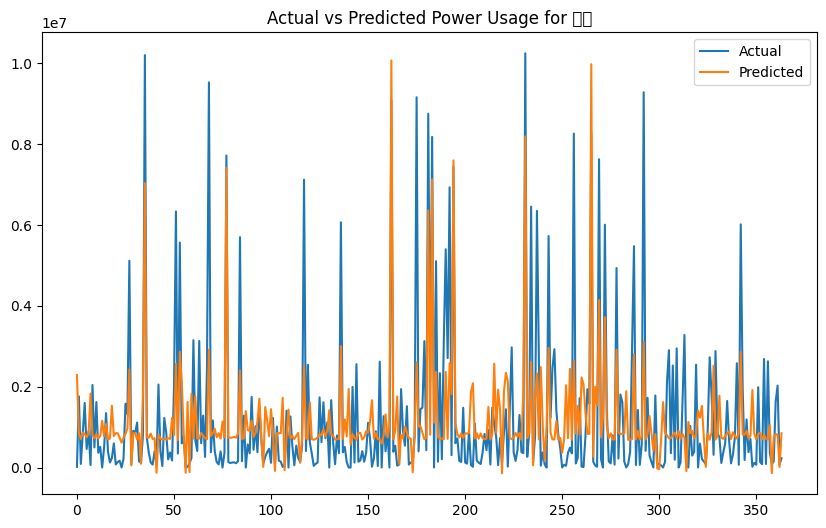

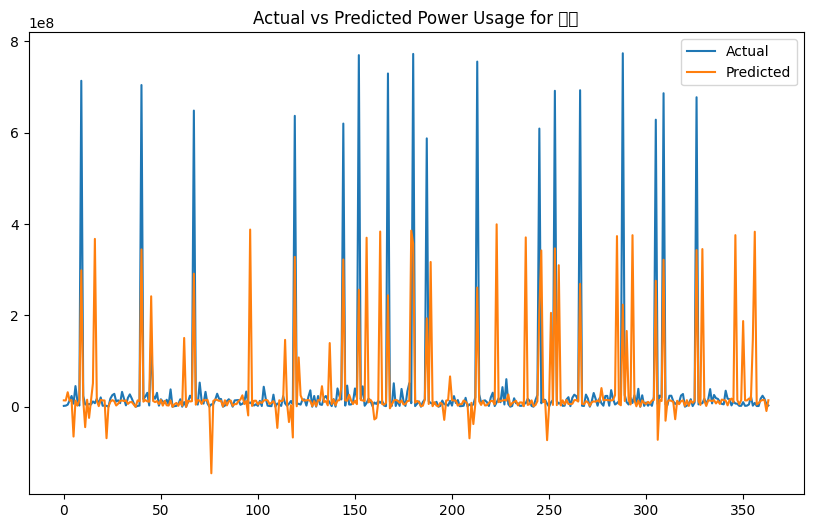

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52632 (\N{HANGUL SYLLABLE CUN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


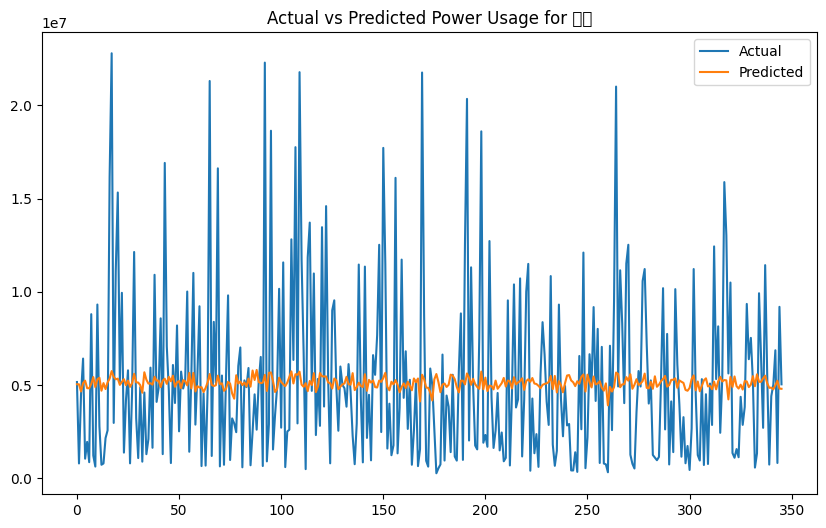

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52649 (\N{HANGUL SYLLABLE CUNG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


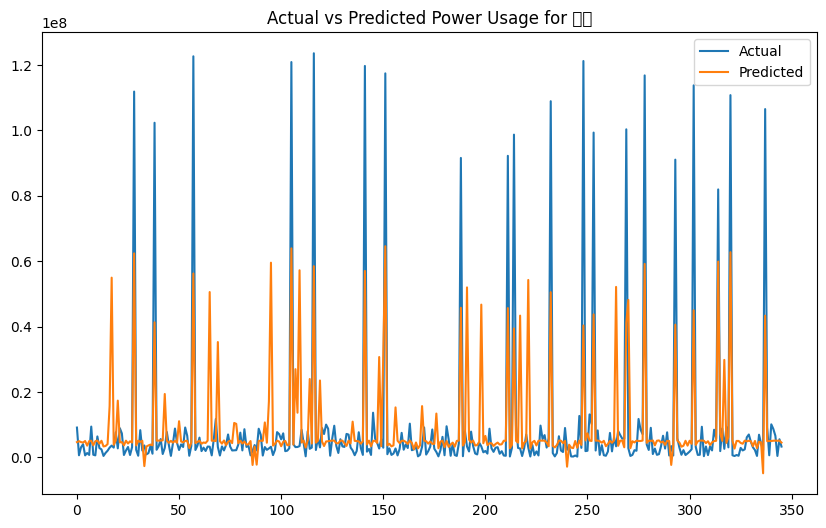

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 53468 (\N{HANGUL SYLLABLE TAE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48177 (\N{HANGUL SYLLABLE BAEG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


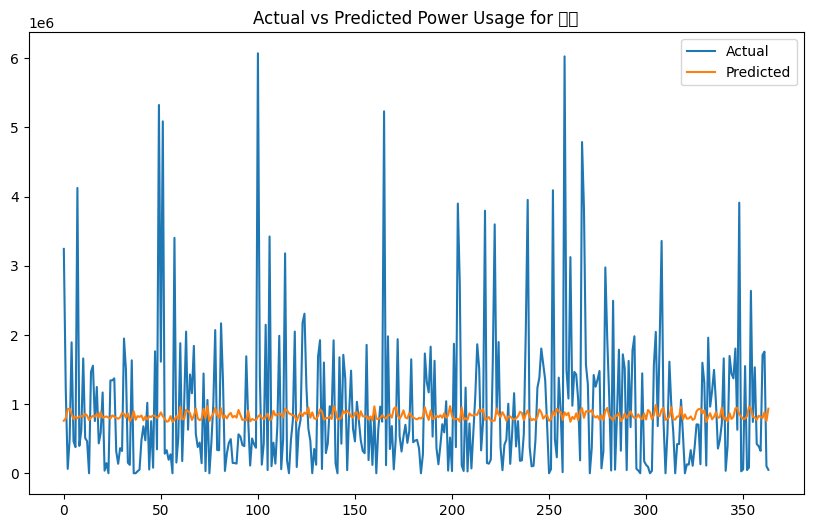

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 53685 (\N{HANGUL SYLLABLE TONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


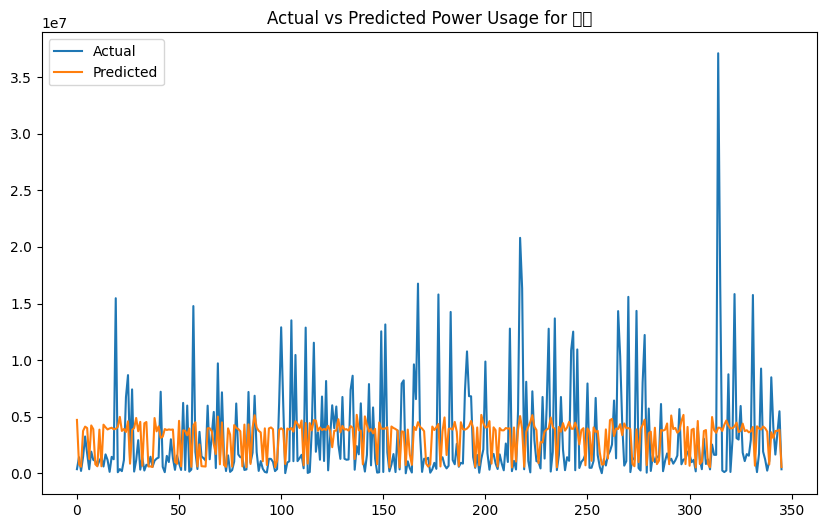

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54028 (\N{HANGUL SYLLABLE PA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


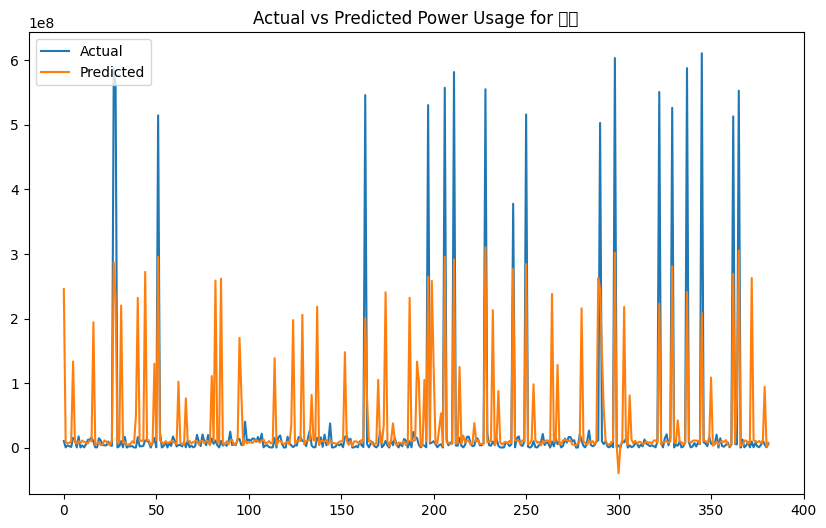

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54637 (\N{HANGUL SYLLABLE HANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


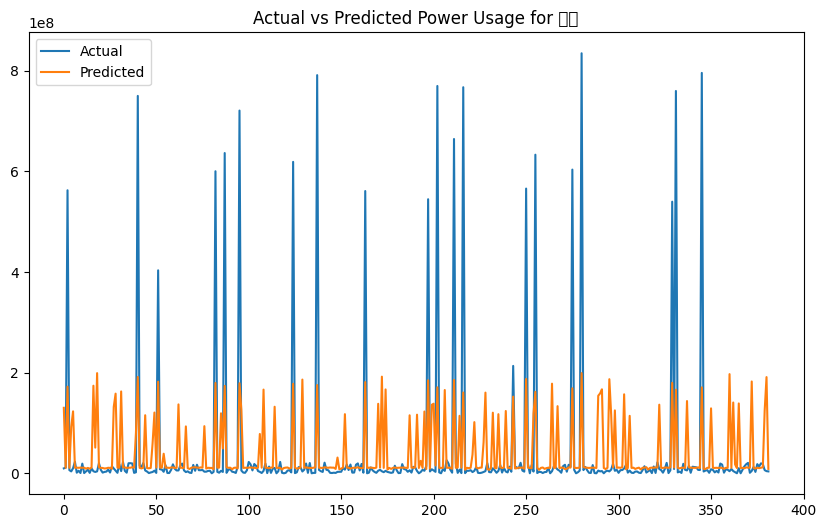

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54633 (\N{HANGUL SYLLABLE HAB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


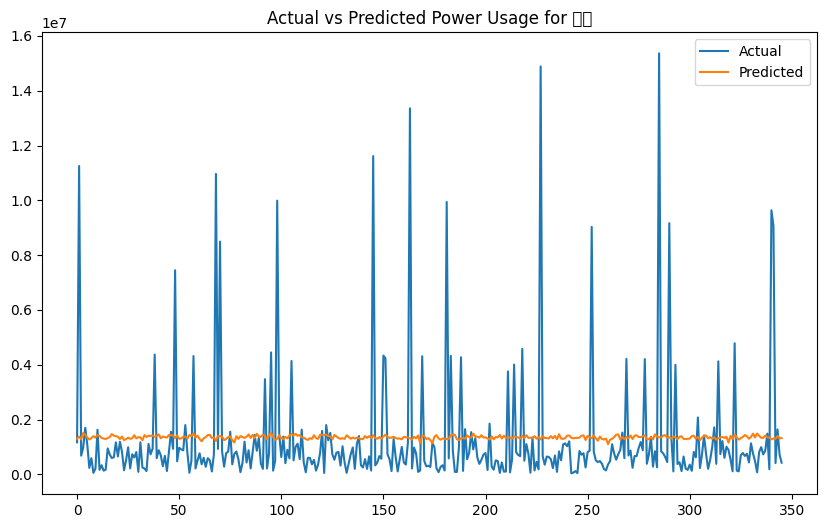

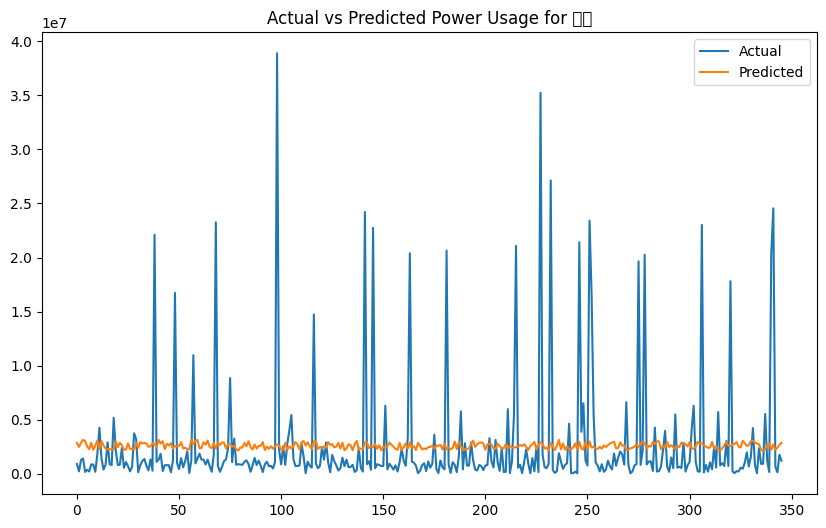

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54861 (\N{HANGUL SYLLABLE HONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


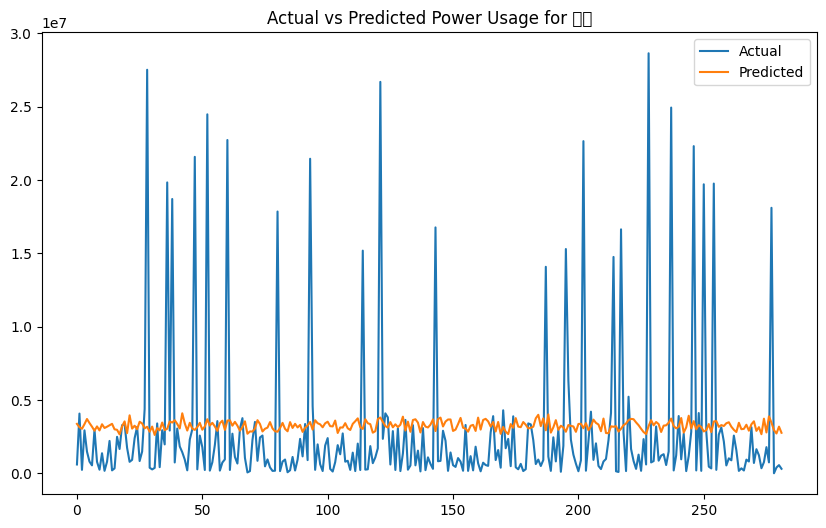

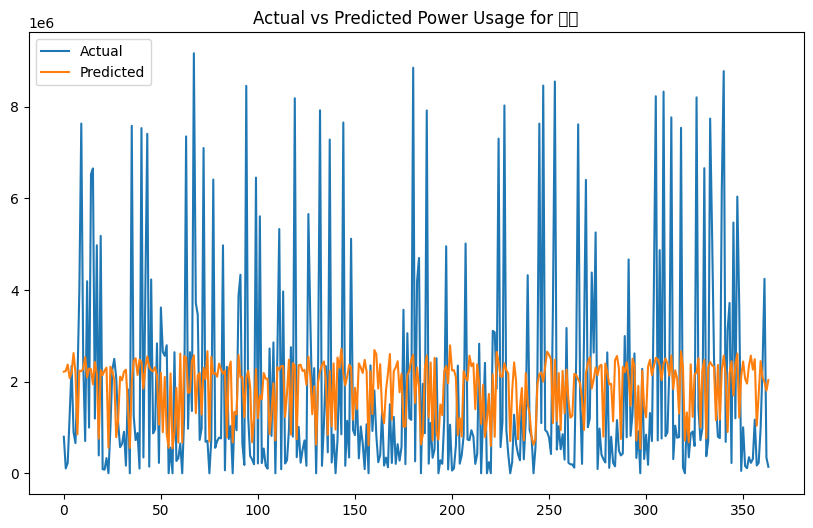

In [ ]:
import matplotlib.pyplot as plt
# 모든 결과를 하나의 데이터프레임으로 결합
all_results = pd.concat(results, ignore_index=True)

# 결과 확인
print(all_results.head())

# 결과 시각화
for city in cities:
    city_results = all_results[all_results['City'] == city]
    plt.figure(figsize=(10, 6))
    plt.plot(city_results['Actual'].values, label='Actual')
    plt.plot(city_results['Predicted'].values, label='Predicted')
    plt.title(f'Actual vs Predicted Power Usage for {city}')
    plt.legend()
    plt.show()


1/1 [==============================] - 0s 22ms/step
Predicted power usage for Sokcho (광업) in 2024-01: 24525652.0
Predicted power usage for Sokcho (광업) in 2024-02: 24310518.0
Predicted power usage for Sokcho (광업) in 2024-03: 24095444.0
Predicted power usage for Sokcho (광업) in 2024-04: 23880592.0
Predicted power usage for Sokcho (광업) in 2024-05: 23666154.0


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44305 (\N{HANGUL SYLLABLE GWANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50629 (\N{HANGUL SYLLABLE EOB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


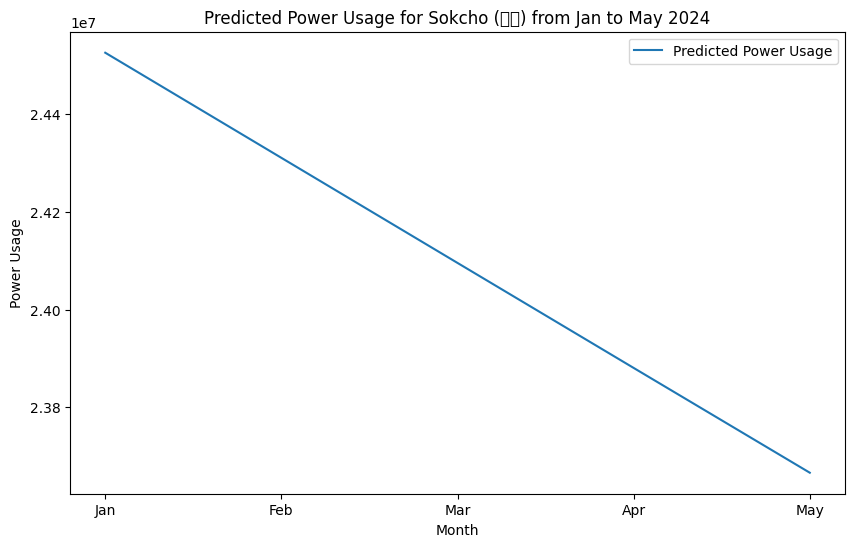

In [ ]:
# 2024년 1월부터 5월까지의 기상 데이터 예측 예제 (속초)
future_weather_data = [
    {"year": 2024, "month": 1, "stnid": 90, "stnko": "속초", "pa": 1015.0, "avgtamax": 5.0, "avgtamin": -3.0, "taavg": 1.0, "avghm": 60, "biz": "광업"},
    {"year": 2024, "month": 2, "stnid": 90, "stnko": "속초", "pa": 1015.2, "avgtamax": 5.2, "avgtamin": -2.8, "taavg": 1.2, "avghm": 61, "biz": "광업"},
    {"year": 2024, "month": 3, "stnid": 90, "stnko": "속초", "pa": 1015.4, "avgtamax": 5.4, "avgtamin": -2.6, "taavg": 1.4, "avghm": 62, "biz": "광업"},
    {"year": 2024, "month": 4, "stnid": 90, "stnko": "속초", "pa": 1015.6, "avgtamax": 5.6, "avgtamin": -2.4, "taavg": 1.6, "avghm": 63, "biz": "광업"},
    {"year": 2024, "month": 5, "stnid": 90, "stnko": "속초", "pa": 1015.8, "avgtamax": 5.8, "avgtamin": -2.2, "taavg": 1.8, "avghm": 64, "biz": "광업"}
]

future_weather_df = pd.DataFrame(future_weather_data)

# 범주형 데이터 인코딩
future_weather_df['biz'] = label_encoder.transform(future_weather_df['biz'])

# 데이터 스케일링
future_X = future_weather_df[['year', 'month', 'stnid', 'pa', 'avgtamax', 'avgtamin', 'taavg', 'avghm', 'biz']].astype(float).values
future_X_scaled = scaler_X.transform(future_X)
future_X_scaled = future_X_scaled.reshape((future_X_scaled.shape[0], 1, future_X_scaled.shape[1]))

# 예측
future_power_usage_pred = model.predict(future_X_scaled)
future_power_usage_pred_inverse = scaler_y.inverse_transform(future_power_usage_pred).flatten()

# 예측 결과 출력
for month, prediction in zip(range(1, 6), future_power_usage_pred_inverse):
    print(f'Predicted power usage for Sokcho (광업) in 2024-{month:02d}: {prediction}')

# 예측 결과 시각화
plt.figure(figsize=(10, 6))
plt.plot(range(1, 6), future_power_usage_pred_inverse, label='Predicted Power Usage')
plt.xticks(range(1, 6), ['Jan', 'Feb', 'Mar', 'Apr', 'May'])
plt.xlabel('Month')
plt.ylabel('Power Usage')
plt.title('Predicted Power Usage for Sokcho (광업) from Jan to May 2024')
plt.legend()
plt.show()


In [ ]:
# 모델 저장 경로 설정
model_save_path = "saved_model/my_model"

# 모델 저장
model.save(model_save_path)
print(f"Model saved to {model_save_path}")


Model saved to saved_model/my_model


<ipython-input-3-5f5f3a02abf0>:124: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(data=city_df, x='date', y='powerUsage', hue='biz', palette='tab20')


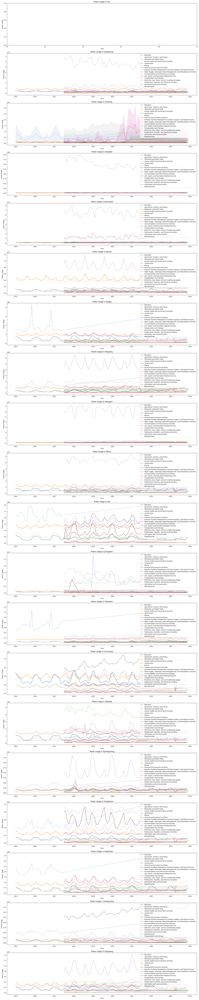

In [ ]:
import json
import pandas as pd
import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# JSON 파일 로드 함수
def load_json_files(pattern):
    files = glob.glob(pattern)
    data_list = []
    for file in files:
        with open(file, 'r', encoding='utf-8') as f:
            data = json.load(f)
            for record in data['data']:
                year = int(record['year'])
                month = int(record['month'])
                record['year'] = year
                record['month'] = month
                data_list.append(record)
    return pd.DataFrame(data_list)

# 한글 도시명과 비즈니스 유형을 영어로 번역하는 딕셔너리
city_translation = {
    "서울": "Seoul", "부산": "Busan", "대구": "Daegu", "인천": "Incheon",
    "광주": "Gwangju", "대전": "Daejeon", "울산": "Ulsan", "세종": "Sejong",
    "수원": "Suwon", "고양": "Goyang", "용인": "Yongin", "성남": "Seongnam",
    "부천": "Bucheon", "화성": "Hwaseong", "남양주": "Namyangju", "안산": "Ansan",
    "안양": "Anyang", "평택": "Pyeongtaek", "의정부": "Uijeongbu", "파주": "Paju",
    "시흥": "Siheung", "김포": "Gimpo", "광명": "Gwangmyeong", "군포": "Gunpo",
    "이천": "Icheon", "오산": "Osan", "하남": "Hanam", "양주": "Yangju",
    "구리": "Guri", "안성": "Anseong", "포천": "Pocheon", "의왕": "Uiwang",
    "여주": "Yeoju", "양평": "Yangpyeong", "동두천": "Dongducheon", "가평": "Gapyeong",
    "춘천": "Chuncheon", "원주": "Wonju", "강릉": "Gangneung", "동해": "Donghae",
    "태백": "Taebaek", "속초": "Sokcho", "삼척": "Samcheok", "홍천": "Hongcheon",
    "횡성": "Hoengseong", "영월": "Yeongwol", "평창": "Pyeongchang", "정선": "Jeongseon",
    "철원": "Cheorwon", "화천": "Hwacheon", "양구": "Yanggu", "인제": "Inje",
    "고성": "Goseong", "양양": "Yangyang", "청주": "Cheongju", "충주": "Chungju",
    "제천": "Jecheon", "보은": "Boeun", "옥천": "Okcheon", "영동": "Yeongdong",
    "진천": "Jincheon", "괴산": "Goesan", "음성": "Eumseong", "단양": "Danyang",
    "천안": "Cheonan", "공주": "Gongju", "보령": "Boryeong", "아산": "Asan",
    "서산": "Seosan", "논산": "Nonsan", "계룡": "Gyeryong", "당진": "Dangjin",
    "금산": "Geumsan", "부여": "Buyeo", "서천": "Seocheon", "청양": "Cheongyang",
    "홍성": "Hongseong", "예산": "Yesan", "태안": "Taean", "전주": "Jeonju",
    "군산": "Gunsan", "익산": "Iksan", "정읍": "Jeongeup", "남원": "Namwon",
    "김제": "Gimje", "완주": "Wanju", "진안": "Jinan", "무주": "Muju",
    "장수": "Jangsu", "임실": "Imsil", "순창": "Sunchang", "고창": "Gochang",
    "부안": "Buan", "목포": "Mokpo", "여수": "Yeosu", "순천": "Suncheon",
    "나주": "Naju", "광양": "Gwangyang", "담양": "Damyang", "곡성": "Gokseong",
    "구례": "Gurye", "고흥": "Goheung", "보성": "Boseong", "화순": "Hwasun",
    "장흥": "Jangheung", "강진": "Gangjin", "해남": "Haenam", "영암": "Yeongam",
    "무안": "Muan", "함평": "Hampyeong", "영광": "Yeonggwang", "장성": "Jangseong",
    "완도": "Wando", "진도": "Jindo", "신안": "Shinan", "포항": "Pohang",
    "경주": "Gyeongju", "김천": "Gimcheon", "안동": "Andong", "구미": "Gumi",
    "영주": "Yeongju", "영천": "Yeongcheon", "상주": "Sangju", "문경": "Mungyeong",
    "경산": "Gyeongsan", "군위": "Gunwi", "의성": "Uiseong", "청송": "Cheongsong",
    "영양": "Yeongyang", "영덕": "Yeongdeok", "청도": "Cheongdo", "고령": "Goryeong",
    "성주": "Seongju", "칠곡": "Chilgok", "예천": "Yecheon", "봉화": "Bonghwa",
    "울진": "Uljin", "울릉": "Ulleung", "창원": "Changwon", "진주": "Jinju",
    "통영": "Tongyeong", "사천": "Sacheon", "김해": "Gimhae", "밀양": "Miryang",
    "거제": "Geoje", "양산": "Yangsan", "의령": "Uiryeong", "함안": "Haman",
    "창녕": "Changnyeong", "고성": "Goseong", "남해": "Namhae", "하동": "Hadong",
    "산청": "Sancheong", "함양": "Hamyang", "거창": "Geochang", "합천": "Hapcheon",
    "제주": "Jeju", "서귀포": "Seogwipo"
}

biz_translation = {
    "농업, 임업 및 어업 ": "Agriculture, Forestry, and Fishing",
    "광업": "Mining",
    "제조업": "Manufacturing",
    "전기, 가스, 증기 및 공기 조절 공급업": "Electricity, Gas, Steam, and Air Conditioning Supply",
    "수도, 하수 및 폐기물 처리, 원료 재생업": "Water Supply, Sewerage, Waste Management, and Remediation Activities",
    "건설업": "Construction",
    "도매 및 소매업": "Wholesale and Retail Trade",
    "운수 및 창고업": "Transportation and Storage",
    "숙박 및 음식점업": "Accommodation and Food Service Activities",
    "정보통신업": "Information and Communication",
    "금융 및 보험업": "Financial and Insurance Activities",
    "부동산업 및 임대업": "Real Estate Activities and Rental and Leasing",
    "전문, 과학 및 기술 서비스업": "Professional, Scientific, and Technical Activities",
    "사업시설 관리, 사업 지원 및 임대 서비스업": "Business Facilities Management, Business Support, and Rental Services",
    "공공 행정, 국방 및 사회 보장 행정": "Public Administration, Defense, and Social Security Administration",
    "교육 서비스업": "Education",
    "보건업 및 사회복지 서비스업": "Human Health and Social Work Activities",
    "예술, 스포츠 및 여가관련 서비스업": "Arts, Sports, and Recreation Related Services",
    "기타 서비스업": "Other Services"
}


# 한글 도시명과 비즈니스 유형을 영어로 번역하는 함수
def translate_columns(df, column_name, translation_dict):
    df[column_name] = df[column_name].map(translation_dict)
    return df

# data 파일에서 city값에서 뒤의 한글자를 제거하는 함수
def preprocess_city_name(city_name):
    if city_name != '전체':
        return city_name[:-1]
    return city_name

# 전력 사용량 데이터 로드
power_df = load_json_files("data_*.json")

# 전력 사용량 데이터에서 city 값 전처리
power_df['city'] = power_df['city'].apply(preprocess_city_name)

# 한글을 영어로 번역
power_df = translate_columns(power_df, 'city', city_translation)
power_df = translate_columns(power_df, 'biz', biz_translation)

# 데이터 전처리
power_df['year'] = power_df['year'].astype(int)
power_df['month'] = power_df['month'].astype(int)
power_df['date'] = pd.to_datetime(power_df[['year', 'month']].assign(day=1))

# 도시별 데이터 제한 (20개 도시만 선택)
selected_cities = power_df['city'].unique()[:20]

# 도시별로 데이터 분리 및 그래프 저장
plt.figure(figsize=(20, len(selected_cities) * 5))
for i, city in enumerate(selected_cities):
    city_df = power_df[power_df['city'] == city]
    plt.subplot(len(selected_cities), 1, i+1)
    sns.lineplot(data=city_df, x='date', y='powerUsage', hue='biz', palette='tab20')
    plt.title(f'Power Usage in {city}')
    plt.xlabel('Time')
    plt.ylabel('Power Usage')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()


<ipython-input-5-52e6f421f58c>:124: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(data=city_df, x='date', y='powerUsage', hue='biz', palette='tab20')


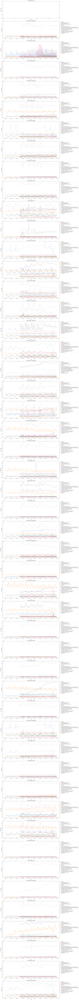

In [ ]:
import json
import pandas as pd
import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# JSON 파일 로드 함수
def load_json_files(pattern):
    files = glob.glob(pattern)
    data_list = []
    for file in files:
        with open(file, 'r', encoding='utf-8') as f:
            data = json.load(f)
            for record in data['data']:
                year = int(record['year'])
                month = int(record['month'])
                record['year'] = year
                record['month'] = month
                data_list.append(record)
    return pd.DataFrame(data_list)

# 한글 도시명과 비즈니스 유형을 영어로 번역하는 딕셔너리
city_translation = {
    "서울": "Seoul", "부산": "Busan", "대구": "Daegu", "인천": "Incheon",
    "광주": "Gwangju", "대전": "Daejeon", "울산": "Ulsan", "세종": "Sejong",
    "수원": "Suwon", "고양": "Goyang", "용인": "Yongin", "성남": "Seongnam",
    "부천": "Bucheon", "화성": "Hwaseong", "남양주": "Namyangju", "안산": "Ansan",
    "안양": "Anyang", "평택": "Pyeongtaek", "의정부": "Uijeongbu", "파주": "Paju",
    "시흥": "Siheung", "김포": "Gimpo", "광명": "Gwangmyeong", "군포": "Gunpo",
    "이천": "Icheon", "오산": "Osan", "하남": "Hanam", "양주": "Yangju",
    "구리": "Guri", "안성": "Anseong", "포천": "Pocheon", "의왕": "Uiwang",
    "여주": "Yeoju", "양평": "Yangpyeong", "동두천": "Dongducheon", "가평": "Gapyeong",
    "춘천": "Chuncheon", "원주": "Wonju", "강릉": "Gangneung", "동해": "Donghae",
    "태백": "Taebaek", "속초": "Sokcho", "삼척": "Samcheok", "홍천": "Hongcheon",
    "횡성": "Hoengseong", "영월": "Yeongwol", "평창": "Pyeongchang", "정선": "Jeongseon",
    "철원": "Cheorwon", "화천": "Hwacheon", "양구": "Yanggu", "인제": "Inje",
    "고성": "Goseong", "양양": "Yangyang", "청주": "Cheongju", "충주": "Chungju",
    "제천": "Jecheon", "보은": "Boeun", "옥천": "Okcheon", "영동": "Yeongdong",
    "진천": "Jincheon", "괴산": "Goesan", "음성": "Eumseong", "단양": "Danyang",
    "천안": "Cheonan", "공주": "Gongju", "보령": "Boryeong", "아산": "Asan",
    "서산": "Seosan", "논산": "Nonsan", "계룡": "Gyeryong", "당진": "Dangjin",
    "금산": "Geumsan", "부여": "Buyeo", "서천": "Seocheon", "청양": "Cheongyang",
    "홍성": "Hongseong", "예산": "Yesan", "태안": "Taean", "전주": "Jeonju",
    "군산": "Gunsan", "익산": "Iksan", "정읍": "Jeongeup", "남원": "Namwon",
    "김제": "Gimje", "완주": "Wanju", "진안": "Jinan", "무주": "Muju",
    "장수": "Jangsu", "임실": "Imsil", "순창": "Sunchang", "고창": "Gochang",
    "부안": "Buan", "목포": "Mokpo", "여수": "Yeosu", "순천": "Suncheon",
    "나주": "Naju", "광양": "Gwangyang", "담양": "Damyang", "곡성": "Gokseong",
    "구례": "Gurye", "고흥": "Goheung", "보성": "Boseong", "화순": "Hwasun",
    "장흥": "Jangheung", "강진": "Gangjin", "해남": "Haenam", "영암": "Yeongam",
    "무안": "Muan", "함평": "Hampyeong", "영광": "Yeonggwang", "장성": "Jangseong",
    "완도": "Wando", "진도": "Jindo", "신안": "Shinan", "포항": "Pohang",
    "경주": "Gyeongju", "김천": "Gimcheon", "안동": "Andong", "구미": "Gumi",
    "영주": "Yeongju", "영천": "Yeongcheon", "상주": "Sangju", "문경": "Mungyeong",
    "경산": "Gyeongsan", "군위": "Gunwi", "의성": "Uiseong", "청송": "Cheongsong",
    "영양": "Yeongyang", "영덕": "Yeongdeok", "청도": "Cheongdo", "고령": "Goryeong",
    "성주": "Seongju", "칠곡": "Chilgok", "예천": "Yecheon", "봉화": "Bonghwa",
    "울진": "Uljin", "울릉": "Ulleung", "창원": "Changwon", "진주": "Jinju",
    "통영": "Tongyeong", "사천": "Sacheon", "김해": "Gimhae", "밀양": "Miryang",
    "거제": "Geoje", "양산": "Yangsan", "의령": "Uiryeong", "함안": "Haman",
    "창녕": "Changnyeong", "고성": "Goseong", "남해": "Namhae", "하동": "Hadong",
    "산청": "Sancheong", "함양": "Hamyang", "거창": "Geochang", "합천": "Hapcheon",
    "제주": "Jeju", "서귀포": "Seogwipo"
}

biz_translation = {
    "농업, 임업 및 어업 ": "Agriculture, Forestry, and Fishing",
    "광업": "Mining",
    "제조업": "Manufacturing",
    "전기, 가스, 증기 및 공기 조절 공급업": "Electricity, Gas, Steam, and Air Conditioning Supply",
    "수도, 하수 및 폐기물 처리, 원료 재생업": "Water Supply, Sewerage, Waste Management, and Remediation Activities",
    "건설업": "Construction",
    "도매 및 소매업": "Wholesale and Retail Trade",
    "운수 및 창고업": "Transportation and Storage",
    "숙박 및 음식점업": "Accommodation and Food Service Activities",
    "정보통신업": "Information and Communication",
    "금융 및 보험업": "Financial and Insurance Activities",
    "부동산업 및 임대업": "Real Estate Activities and Rental and Leasing",
    "전문, 과학 및 기술 서비스업": "Professional, Scientific, and Technical Activities",
    "사업시설 관리, 사업 지원 및 임대 서비스업": "Business Facilities Management, Business Support, and Rental Services",
    "공공 행정, 국방 및 사회 보장 행정": "Public Administration, Defense, and Social Security Administration",
    "교육 서비스업": "Education",
    "보건업 및 사회복지 서비스업": "Human Health and Social Work Activities",
    "예술, 스포츠 및 여가관련 서비스업": "Arts, Sports, and Recreation Related Services",
    "기타 서비스업": "Other Services"
}


# 한글 도시명과 비즈니스 유형을 영어로 번역하는 함수
def translate_columns(df, column_name, translation_dict):
    df[column_name] = df[column_name].map(translation_dict)
    return df

# data 파일에서 city값에서 뒤의 한글자를 제거하는 함수
def preprocess_city_name(city_name):
    if city_name != '전체':
        return city_name[:-1]
    return city_name

# 전력 사용량 데이터 로드
power_df = load_json_files("data_*.json")

# 전력 사용량 데이터에서 city 값 전처리
power_df['city'] = power_df['city'].apply(preprocess_city_name)

# 한글을 영어로 번역
power_df = translate_columns(power_df, 'city', city_translation)
power_df = translate_columns(power_df, 'biz', biz_translation)

# 데이터 전처리
power_df['year'] = power_df['year'].astype(int)
power_df['month'] = power_df['month'].astype(int)
power_df['date'] = pd.to_datetime(power_df[['year', 'month']].assign(day=1))

# 도시별 데이터 제한 (20개 도시만 선택)
selected_cities = power_df['city'].unique()[:50]

# 도시별로 데이터 분리 및 그래프 저장
plt.figure(figsize=(20, len(selected_cities) * 5))
for i, city in enumerate(selected_cities):
    city_df = power_df[power_df['city'] == city]
    plt.subplot(len(selected_cities), 1, i+1)
    sns.lineplot(data=city_df, x='date', y='powerUsage', hue='biz', palette='tab20')
    plt.title(f'Power Usage in {city}')
    plt.xlabel('Time')
    plt.ylabel('Power Usage')
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize='small')

plt.tight_layout()
plt.show()
